In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import seaborn as sns
import os
import pandas as pd
import random
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
import datetime, os
import io
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.mixture import GaussianMixture



# Read data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Name of columns.

columns = ["engine_no", "cycles", "opc1", "opc2", "opc3", "tfan_in_tot", "tLPC_out_tot", "tHPC_out_tot",
           "tLPT_out_tot", "pfan_in", "pbypass_tot", "pHPC_out_tot", "fan_speed_physical", "core_speed_physical",
           "P50_P2_ratio", "pHPC_out_stat", "fuel_flow_to_Ps30", "fan_speed_corrected", "core_speed_corrected",
           "bypass_ratio", "burnerfuel_air_ratio", "bleed_enthalpy", "fan_speed_demanded", "fan_speed_demanded_corrected" ,
           "HPT_coolant_bleed", "LPT_coolant_bleed"]
len(columns)

26

In [ ]:
sensors = ['tLPC_out_tot', 'tHPC_out_tot', 'tLPT_out_tot', 'pbypass_tot',
       'pHPC_out_tot', 'fan_speed_physical', 'core_speed_physical',
       'pHPC_out_stat', 'fuel_flow_to_Ps30', 'fan_speed_corrected',
       'core_speed_corrected', 'bypass_ratio', 'bleed_enthalpy',
       'HPT_coolant_bleed', 'LPT_coolant_bleed']

In [ ]:
import os
os.chdir('/content/drive/MyDrive')

Read all the datasets. Train, Test and RUL.

In [ ]:
base_engines1 = pd.read_csv("./CMAPSSData/train_FD001.txt", delim_whitespace=True, names=columns, header=None, index_col=False)
base_engines2 = pd.read_csv("./CMAPSSData/train_FD002.txt", delim_whitespace=True, names=columns, header=None, index_col=False)
base_engines3 = pd.read_csv("./CMAPSSData/train_FD003.txt", delim_whitespace=True, names=columns, header=None, index_col=False)
base_engines4 = pd.read_csv("./CMAPSSData/train_FD004.txt", delim_whitespace=True, names=columns, header=None, index_col=False)


In [ ]:
base_test1 = pd.read_csv("./CMAPSSData/test_FD001.txt", delim_whitespace=True, names=columns, header=None, index_col=False)
base_test2 = pd.read_csv("./CMAPSSData/test_FD002.txt", delim_whitespace=True, names=columns, header=None, index_col=False)
base_test3 = pd.read_csv("./CMAPSSData/test_FD003.txt", delim_whitespace=True, names=columns, header=None, index_col=False)
base_test4 = pd.read_csv("./CMAPSSData/test_FD004.txt", delim_whitespace=True, names=columns, header=None, index_col=False)


In [ ]:
base_test1

,engine_no,cycles,opc1,opc2,opc3,tfan_in_tot,tLPC_out_tot,tHPC_out_tot,tLPT_out_tot,pfan_in,...,fuel_flow_to_Ps30,fan_speed_corrected,core_speed_corrected,bypass_ratio,burnerfuel_air_ratio,bleed_enthalpy,fan_speed_demanded,fan_speed_demanded_corrected,HPT_coolant_bleed,LPT_coolant_bleed
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,...,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,...,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,...,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,...,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,...,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13091,100,194,0.0049,0.0000,100.0,518.67,643.24,1599.45,1415.79,14.62,...,520.69,2388.00,8213.28,8.4715,0.03,394,2388,100.0,38.65,23.1974
13092,100,195,-0.0011,-0.0001,100.0,518.67,643.22,1595.69,1422.05,14.62,...,521.05,2388.09,8210.85,8.4512,0.03,395,2388,100.0,38.57,23.2771
13093,100,196,-0.0006,-0.0003,100.0,518.67,643.44,1593.15,1406.82,14.62,...,521.18,2388.04,8217.24,8.4569,0.03,395,2388,100.0,38.62,23.2051
13094,100,197,-0.0038,0.0001,100.0,518.67,643.26,1594.99,1419.36,14.62,...,521.33,2388.08,8220.48,8.4711,0.03,395,2388,100.0,38.66,23.2699


In [ ]:
RUL1 = pd.read_csv("./CMAPSSData/RUL_FD001.txt", names=['RUL'], header=None)
RUL1 = pd.read_csv("./CMAPSSData/RUL_FD001.txt", header=None)

RUL2 = pd.read_csv("./CMAPSSData/RUL_FD002.txt", names=['RUL'], header=None)
RUL3 = pd.read_csv("./CMAPSSData/RUL_FD003.txt", names=['RUL'], header=None)
RUL4 = pd.read_csv("./CMAPSSData/RUL_FD004.txt", names=['RUL'], header=None)


# Completeness of data

In [ ]:
# verify that each engine has all cycles
def check_cycles_completeness(df):
    """Function that checks if there is any missing cycle in any of the engines in the data
    Args:
        df (DataFrame): DataFrame with sensor data
    """
    engines_no_1 = df.engine_no.unique()
    count = 0
    for n in engines_no_1:
        if df[df.engine_no==n].cycles.max() != df[df.engine_no==n].shape[0]:
            print(f"missing cycle for engine {n}")
            count += 1
    print(f"{count} engines had missing cycles")

In [ ]:
check_cycles_completeness(base_engines1)
check_cycles_completeness(base_engines2)
check_cycles_completeness(base_engines3)
check_cycles_completeness(base_engines4)

0 engines had missing cycles
0 engines had missing cycles
0 engines had missing cycles
0 engines had missing cycles


# Normality and statistical analysis

Checking for nulls in all the training dataset.

In [ ]:
base_engines1.isnull().sum()

engine_no                       0
cycles                          0
opc1                            0
opc2                            0
opc3                            0
tfan_in_tot                     0
tLPC_out_tot                    0
tHPC_out_tot                    0
tLPT_out_tot                    0
pfan_in                         0
pbypass_tot                     0
pHPC_out_tot                    0
fan_speed_physical              0
core_speed_physical             0
P50_P2_ratio                    0
pHPC_out_stat                   0
fuel_flow_to_Ps30               0
fan_speed_corrected             0
core_speed_corrected            0
bypass_ratio                    0
burnerfuel_air_ratio            0
bleed_enthalpy                  0
fan_speed_demanded              0
fan_speed_demanded_corrected    0
HPT_coolant_bleed               0
LPT_coolant_bleed               0
dtype: int64

In [ ]:
base_engines2.isnull().sum()

engine_no                       0
cycles                          0
opc1                            0
opc2                            0
opc3                            0
tfan_in_tot                     0
tLPC_out_tot                    0
tHPC_out_tot                    0
tLPT_out_tot                    0
pfan_in                         0
pbypass_tot                     0
pHPC_out_tot                    0
fan_speed_physical              0
core_speed_physical             0
P50_P2_ratio                    0
pHPC_out_stat                   0
fuel_flow_to_Ps30               0
fan_speed_corrected             0
core_speed_corrected            0
bypass_ratio                    0
burnerfuel_air_ratio            0
bleed_enthalpy                  0
fan_speed_demanded              0
fan_speed_demanded_corrected    0
HPT_coolant_bleed               0
LPT_coolant_bleed               0
dtype: int64

In [ ]:
base_engines3.isnull().sum()

engine_no                       0
cycles                          0
opc1                            0
opc2                            0
opc3                            0
tfan_in_tot                     0
tLPC_out_tot                    0
tHPC_out_tot                    0
tLPT_out_tot                    0
pfan_in                         0
pbypass_tot                     0
pHPC_out_tot                    0
fan_speed_physical              0
core_speed_physical             0
P50_P2_ratio                    0
pHPC_out_stat                   0
fuel_flow_to_Ps30               0
fan_speed_corrected             0
core_speed_corrected            0
bypass_ratio                    0
burnerfuel_air_ratio            0
bleed_enthalpy                  0
fan_speed_demanded              0
fan_speed_demanded_corrected    0
HPT_coolant_bleed               0
LPT_coolant_bleed               0
dtype: int64

In [ ]:
base_engines4.isnull().sum()

engine_no                       0
cycles                          0
opc1                            0
opc2                            0
opc3                            0
tfan_in_tot                     0
tLPC_out_tot                    0
tHPC_out_tot                    0
tLPT_out_tot                    0
pfan_in                         0
pbypass_tot                     0
pHPC_out_tot                    0
fan_speed_physical              0
core_speed_physical             0
P50_P2_ratio                    0
pHPC_out_stat                   0
fuel_flow_to_Ps30               0
fan_speed_corrected             0
core_speed_corrected            0
bypass_ratio                    0
burnerfuel_air_ratio            0
bleed_enthalpy                  0
fan_speed_demanded              0
fan_speed_demanded_corrected    0
HPT_coolant_bleed               0
LPT_coolant_bleed               0
dtype: int64

In [ ]:
base_engines1.describe(include='all').T

,count,mean,std,min,25%,50%,75%,max
engine_no,20631.0,51.506568,2.922763e+01,1.0000,26.0000,52.0000,77.0000,100.0000
cycles,20631.0,108.807862,6.888099e+01,1.0000,52.0000,104.0000,156.0000,362.0000
opc1,20631.0,-0.000009,2.187313e-03,-0.0087,-0.0015,0.0000,0.0015,0.0087
opc2,20631.0,0.000002,2.930621e-04,-0.0006,-0.0002,0.0000,0.0003,0.0006
opc3,20631.0,100.000000,0.000000e+00,100.0000,100.0000,100.0000,100.0000,100.0000
tfan_in_tot,20631.0,518.670000,0.000000e+00,518.6700,518.6700,518.6700,518.6700,518.6700
tLPC_out_tot,20631.0,642.680934,5.000533e-01,641.2100,642.3250,642.6400,643.0000,644.5300
tHPC_out_tot,20631.0,1590.523119,6.131150e+00,1571.0400,1586.2600,1590.1000,1594.3800,1616.9100
tLPT_out_tot,20631.0,1408.933782,9.000605e+00,1382.2500,1402.3600,1408.0400,1414.5550,1441.4900
pfan_in,20631.0,14.620000,1.776400e-15,14.6200,14.6200,14.6200,14.6200,14.6200


In [ ]:
base_engines2.describe(include='all')

,engine_no,cycles,opc1,opc2,opc3,tfan_in_tot,tLPC_out_tot,tHPC_out_tot,tLPT_out_tot,pfan_in,...,fuel_flow_to_Ps30,fan_speed_corrected,core_speed_corrected,bypass_ratio,burnerfuel_air_ratio,bleed_enthalpy,fan_speed_demanded,fan_speed_demanded_corrected,HPT_coolant_bleed,LPT_coolant_bleed
count,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,...,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000,53759.000000
mean,131.082981,109.154746,23.998407,0.572056,94.046020,472.910207,579.672399,1419.971013,1205.442024,8.031986,...,266.069034,2334.557253,8066.597682,9.329654,0.023326,348.309511,2228.806358,97.756838,20.789296,12.473423
std,74.463862,69.180569,14.747376,0.310016,14.237735,26.389707,37.289399,105.946341,119.123428,3.613839,...,137.659507,128.068271,84.837950,0.749335,0.004711,27.754515,145.327980,5.364067,9.869331,5.921615
min,1.000000,1.000000,0.000000,0.000000,60.000000,445.000000,535.530000,1243.730000,1023.770000,3.910000,...,129.120000,2027.610000,7848.360000,8.335700,0.020000,303.000000,1915.000000,84.930000,10.180000,6.010500
25%,68.000000,52.000000,10.004600,0.250700,100.000000,445.000000,549.570000,1352.760000,1123.655000,3.910000,...,131.520000,2387.900000,8062.140000,8.677800,0.020000,331.000000,2212.000000,100.000000,10.910000,6.546300
50%,131.000000,104.000000,25.001300,0.700000,100.000000,462.540000,555.980000,1369.180000,1138.890000,7.050000,...,183.200000,2388.080000,8082.540000,9.310900,0.020000,335.000000,2223.000000,100.000000,14.880000,8.929200
75%,195.000000,157.000000,41.998000,0.840000,100.000000,491.190000,607.340000,1499.370000,1306.850000,10.520000,...,371.260000,2388.170000,8127.195000,9.386900,0.030000,369.000000,2324.000000,100.000000,28.470000,17.083200
max,260.000000,378.000000,42.008000,0.842000,100.000000,518.670000,644.520000,1612.880000,1439.230000,14.620000,...,523.370000,2390.480000,8268.500000,11.066900,0.030000,399.000000,2388.000000,100.000000,39.340000,23.590100


In [ ]:
base_engines3.describe(include='all')

,engine_no,cycles,opc1,opc2,opc3,tfan_in_tot,tLPC_out_tot,tHPC_out_tot,tLPT_out_tot,pfan_in,...,fuel_flow_to_Ps30,fan_speed_corrected,core_speed_corrected,bypass_ratio,burnerfuel_air_ratio,bleed_enthalpy,fan_speed_demanded,fan_speed_demanded_corrected,HPT_coolant_bleed,LPT_coolant_bleed
count,24720.000000,24720.000000,24720.000000,24720.000000,24720.0,24720.00,24720.000000,24720.000000,24720.000000,2.472000e+04,...,24720.000000,24720.000000,24720.000000,24720.000000,2.472000e+04,24720.000000,24720.0,24720.0,24720.000000,24720.000000
mean,48.631877,139.077063,-0.000024,0.000005,100.0,518.67,642.457858,1588.079175,1404.471212,1.462000e+01,...,523.050873,2388.071643,8144.202916,8.396176,3.000000e-02,392.566545,2388.0,100.0,38.988552,23.393024
std,29.348985,98.846675,0.002194,0.000294,0.0,0.00,0.523031,6.810418,9.773178,3.552786e-15,...,3.255314,0.158121,16.504118,0.060512,1.734759e-17,1.761459,0.0,0.0,0.248865,0.149234
min,1.000000,1.000000,-0.008600,-0.000600,100.0,518.67,640.840000,1564.300000,1377.060000,1.462000e+01,...,517.770000,2386.930000,8099.680000,8.156300,3.000000e-02,388.000000,2388.0,100.0,38.170000,22.872600
25%,23.000000,62.000000,-0.001500,-0.000200,100.0,518.67,642.080000,1583.280000,1397.187500,1.462000e+01,...,521.150000,2388.010000,8134.510000,8.360600,3.000000e-02,391.000000,2388.0,100.0,38.830000,23.296200
50%,47.000000,124.000000,-0.000000,-0.000000,100.0,518.67,642.400000,1587.520000,1402.910000,1.462000e+01,...,521.980000,2388.070000,8141.200000,8.398300,3.000000e-02,392.000000,2388.0,100.0,38.990000,23.391600
75%,74.000000,191.000000,0.001500,0.000300,100.0,518.67,642.790000,1592.412500,1410.600000,1.462000e+01,...,523.840000,2388.140000,8149.230000,8.437000,3.000000e-02,394.000000,2388.0,100.0,39.140000,23.483300
max,100.000000,525.000000,0.008600,0.000700,100.0,518.67,645.110000,1615.390000,1441.160000,1.462000e+01,...,537.400000,2388.610000,8290.550000,8.570500,3.000000e-02,399.000000,2388.0,100.0,39.850000,23.950500


In [ ]:
base_engines4.describe(include='all')

,engine_no,cycles,opc1,opc2,opc3,tfan_in_tot,tLPC_out_tot,tHPC_out_tot,tLPT_out_tot,pfan_in,...,fuel_flow_to_Ps30,fan_speed_corrected,core_speed_corrected,bypass_ratio,burnerfuel_air_ratio,bleed_enthalpy,fan_speed_demanded,fan_speed_demanded_corrected,HPT_coolant_bleed,LPT_coolant_bleed
count,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,...,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000,61249.000000
mean,124.325181,134.311417,23.999823,0.571347,94.031576,472.882435,579.420056,1417.896600,1201.915359,8.031626,...,266.735665,2334.427590,8067.811812,9.285604,0.023252,347.760029,2228.613283,97.751396,20.864333,12.518995
std,71.995350,89.783389,14.780722,0.310703,14.251954,26.436832,37.342647,106.167598,119.327591,3.622872,...,138.479109,128.197859,85.670543,0.750374,0.004685,27.808283,145.472491,5.369424,9.936396,5.962697
min,1.000000,1.000000,0.000000,0.000000,60.000000,445.000000,535.480000,1242.670000,1024.420000,3.910000,...,128.310000,2027.570000,7845.780000,8.175700,0.020000,302.000000,1915.000000,84.930000,10.160000,6.084300
25%,60.000000,62.000000,10.004600,0.250700,100.000000,445.000000,549.330000,1350.550000,1119.490000,3.910000,...,134.520000,2387.910000,8062.630000,8.648000,0.020000,330.000000,2212.000000,100.000000,10.940000,6.566100
50%,126.000000,123.000000,25.001400,0.700000,100.000000,462.540000,555.740000,1367.680000,1136.920000,7.050000,...,183.450000,2388.060000,8083.810000,9.255600,0.020000,334.000000,2223.000000,100.000000,14.930000,8.960100
75%,185.000000,191.000000,41.998100,0.840000,100.000000,491.190000,607.070000,1497.420000,1302.620000,10.520000,...,371.400000,2388.170000,8128.350000,9.365800,0.030000,368.000000,2324.000000,100.000000,28.560000,17.135500
max,249.000000,543.000000,42.008000,0.842000,100.000000,518.670000,644.420000,1613.000000,1440.770000,14.620000,...,537.490000,2390.490000,8261.650000,11.066300,0.030000,399.000000,2388.000000,100.000000,39.890000,23.885200


In [ ]:
engines1 = base_engines1.copy()
engines2 = base_engines2.copy()
engines3 = base_engines3.copy()
engines4 = base_engines4.copy()

From the boxplots, correlation matrix and statistical data of the dataset we can see that some of the variables are constant. So they do nothing for the prediction of RUL. We remove variable that are constants from the dataset 1. We also remove the labels cycle and engine_no, and the target variable.

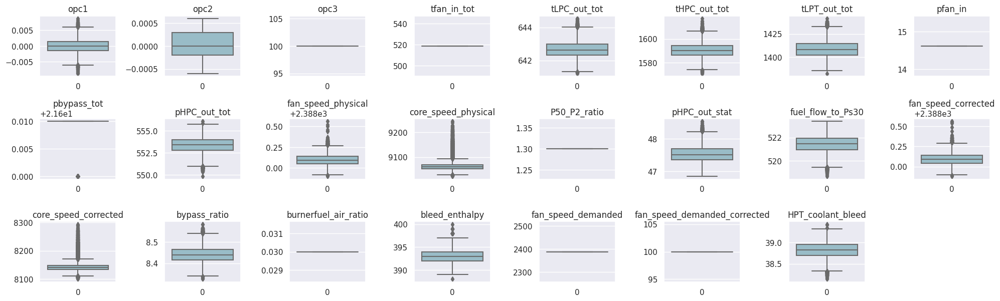

In [ ]:
# Distribution of variables
sns.set()
fig = plt.figure(figsize = [20,10])
cols = engines1.columns[2:-1]
cnt = 1
for col in cols:
    plt.subplot(5,8,cnt)
    sns.boxplot(engines1[col], color='#91c0cf')
    plt.title(col)
    cnt+=1
plt.tight_layout()
plt.show()

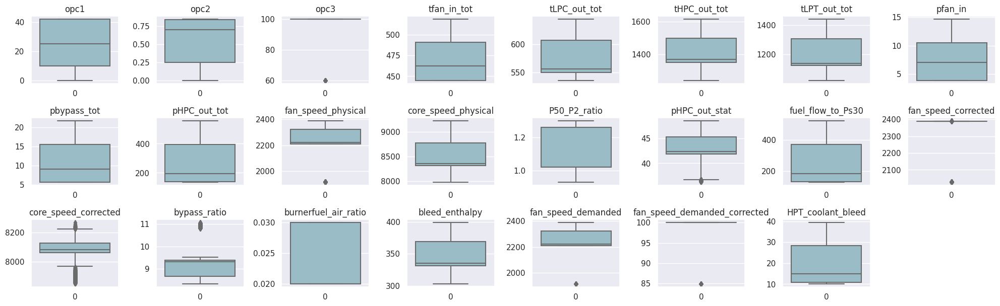

In [ ]:
# Distribution of variables
sns.set()
fig = plt.figure(figsize = [20,10])
cols = engines2.columns[2:-1]
cnt = 1
for col in cols:
    plt.subplot(5,8,cnt)
    sns.boxplot(engines2[col], color='#91c0cf')
    plt.title(col)
    cnt+=1
plt.tight_layout()
plt.show()

Index after dropping na

# Z Score

In [ ]:
import scipy.stats as stats
import numpy as np
def zscore(df, degree=3.0):
    data = df.copy()
    data['zscore'] = (data - data.mean())/data.std()
    outliers = data[data.zscore <= -degree]
    return outliers['tLPC_out_tot'], data


In [ ]:
def modif_zscore(df, degree=3):
    data = df.copy()
    data.columns = ['values']
    s = stats.norm.ppf(0.75)
    numerator = s*(data-data.median())
    MAD = np.abs(data- data.median()).median()
    data['m_zscore'] = numerator/MAD
    outliers = data[(data['m_zscore']>degree) | (data['m_zscore']< -degree) ]
    return outliers['values'], data

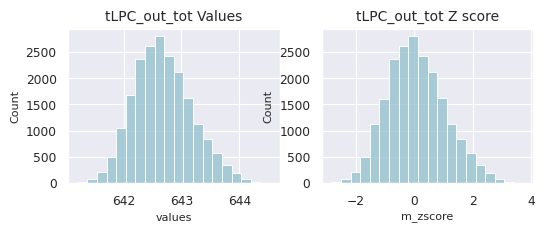

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


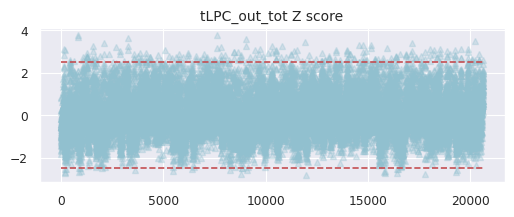

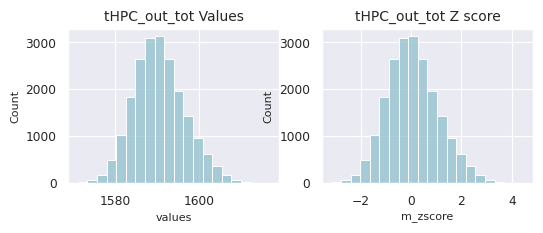

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


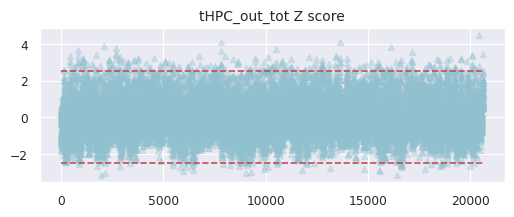

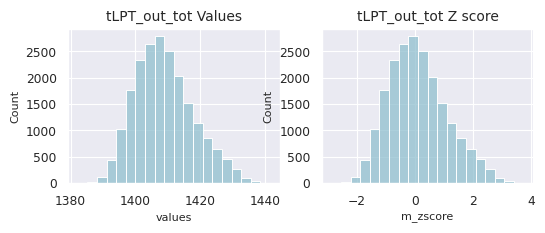

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


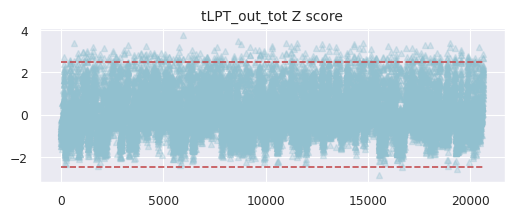

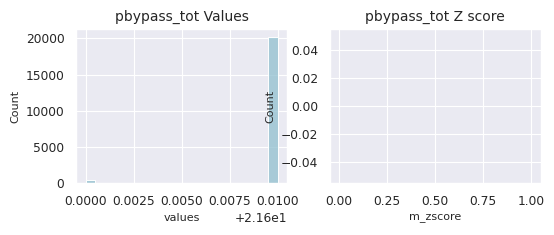

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


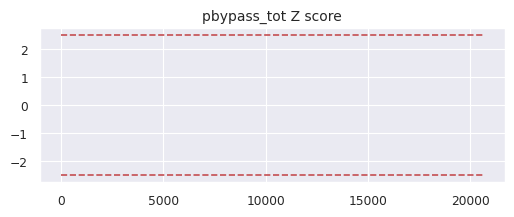

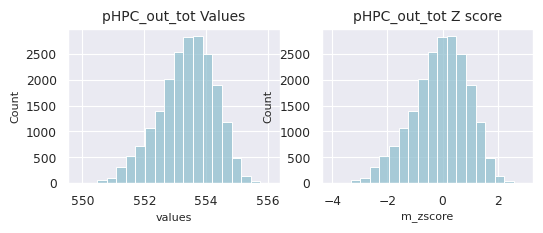

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


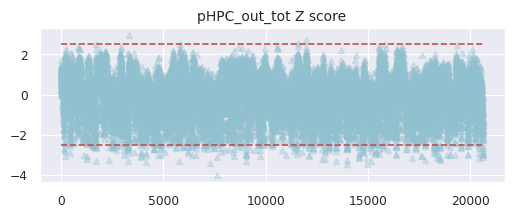

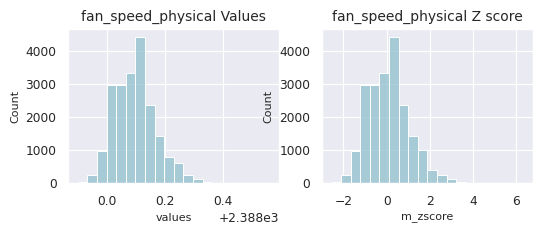

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


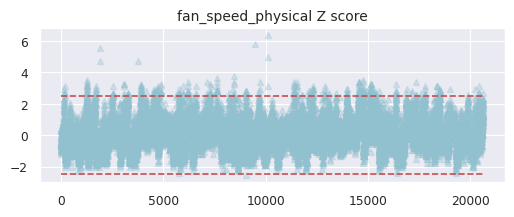

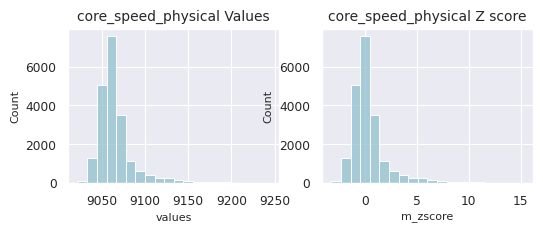

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


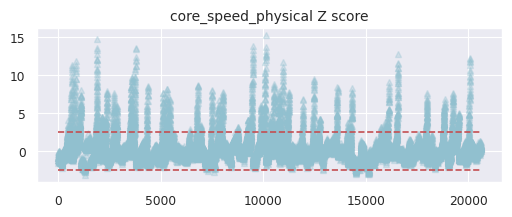

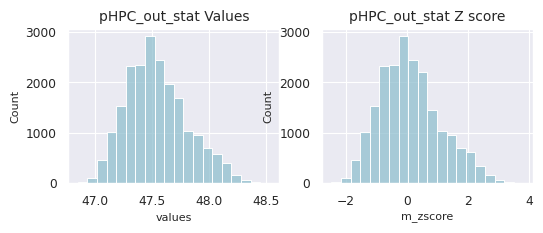

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


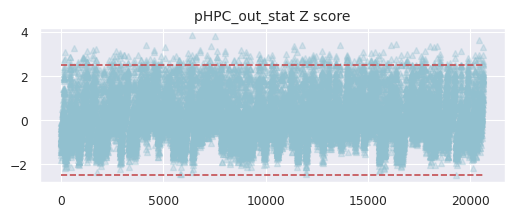

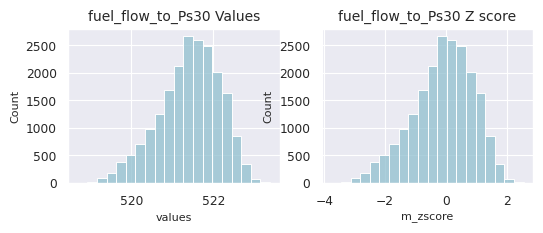

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


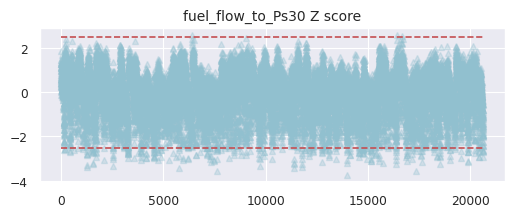

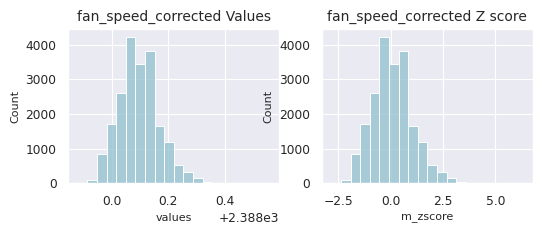

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


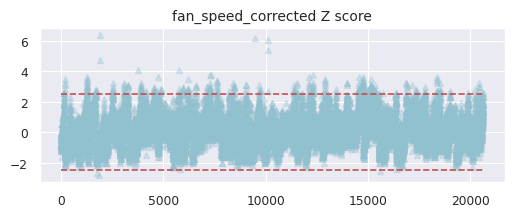

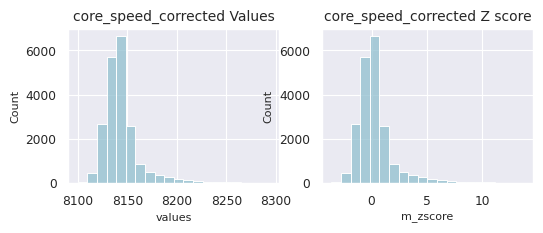

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


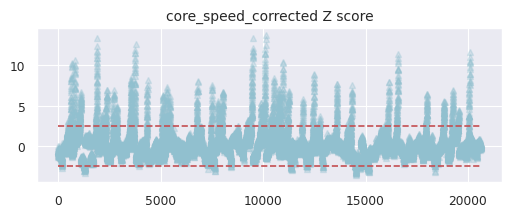

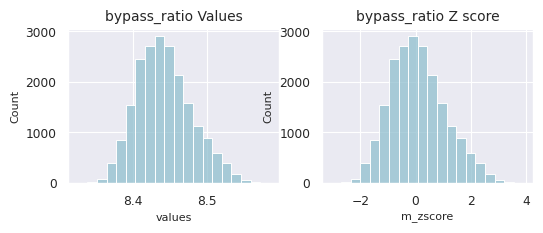

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


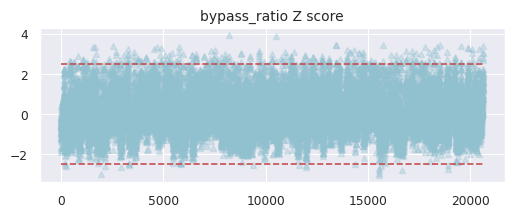

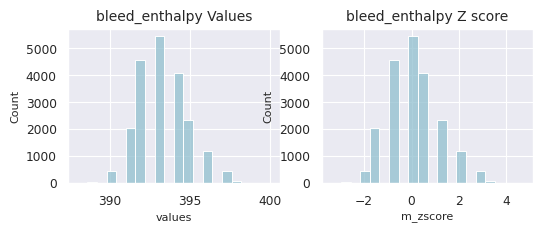

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


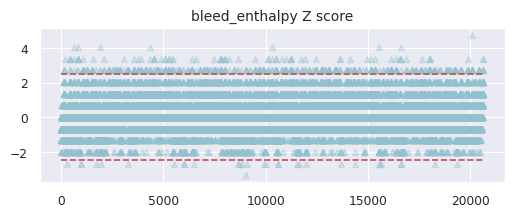

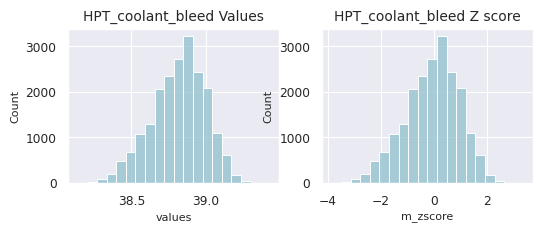

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


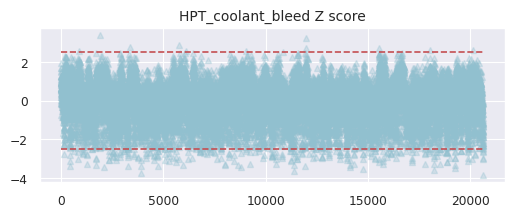

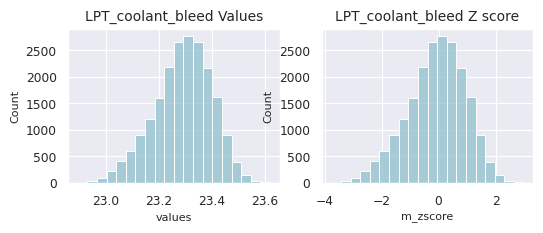

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


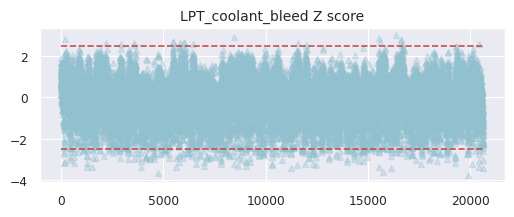

In [ ]:

sensors = ['tLPC_out_tot', 'tHPC_out_tot', 'tLPT_out_tot', 'pbypass_tot',
       'pHPC_out_tot', 'fan_speed_physical', 'core_speed_physical',
       'pHPC_out_stat', 'fuel_flow_to_Ps30', 'fan_speed_corrected',
       'core_speed_corrected', 'bypass_ratio', 'bleed_enthalpy',
       'HPT_coolant_bleed', 'LPT_coolant_bleed']

def plot_zscore(data, d=3):
    n = len(data)
    plt.figure(figsize=(6,2))
    plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)
    plt.plot([0,n],[d,d],'r--')
    plt.plot([0,n],[-d,-d],'r--')



outliers_all, transformed_all = [], []
for col in engines1[sensors].columns:
    outliers, transformed = modif_zscore(engines1[[col]])
    outliers_all.append(outliers)
    transformed_all.append(transformed)

    sns.set_context("paper", rc={"font.size":2,"axes.titlesize":10,"axes.labelsize":8})
    fig, axes = plt.subplots(1, 2, figsize=(6,2))
    sns.histplot(ax=axes[0], data=transformed, x=transformed['values'], bins=20, color = '#91c0cf').set(title=f'{col} Values')
    sns.histplot(ax=axes[1], data=transformed, x=transformed['m_zscore'], bins=20, color = '#91c0cf').set(title=f'{col} Z score')

    plt.savefig(f"/content/drive/MyDrive/images/{col}hist-z.png",
            bbox_inches ="tight",
            pad_inches = 1,
            transparent = True,
            edgecolor ='w',
            orientation ='landscape')
    plt.show()

    plot_zscore(transformed['m_zscore'].values, d=2.5)
    plt.title(f"{col} Z score")


    plt.savefig(f"/content/drive/MyDrive/images/{col}z.png",
            bbox_inches ="tight",
            pad_inches = 1,
            transparent = True,
            edgecolor ='w',
            orientation ='landscape')

    plt.show()

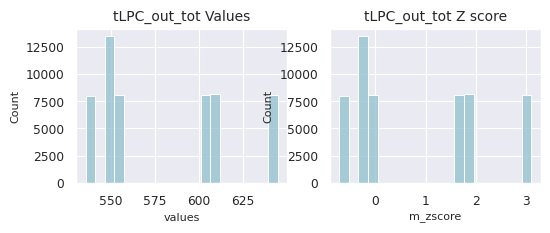

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


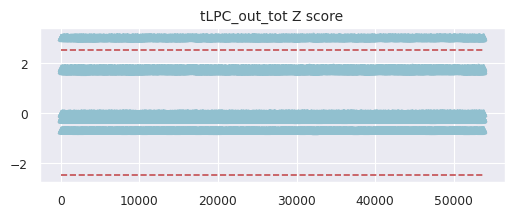

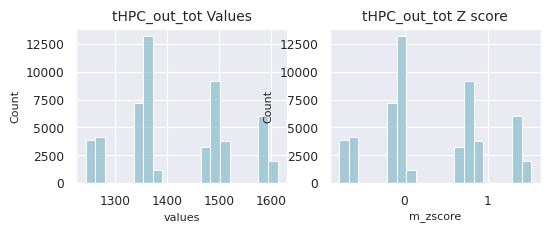

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


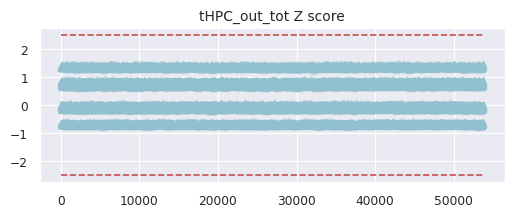

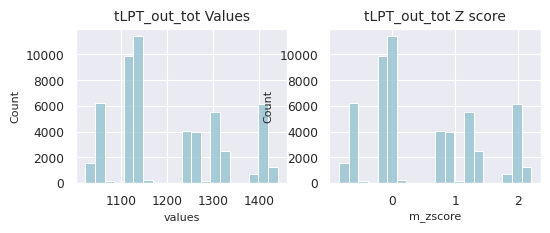

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


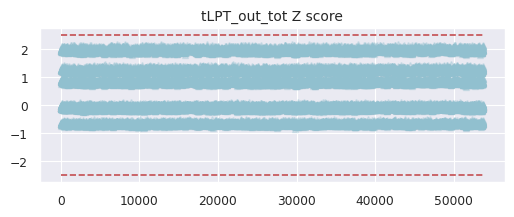

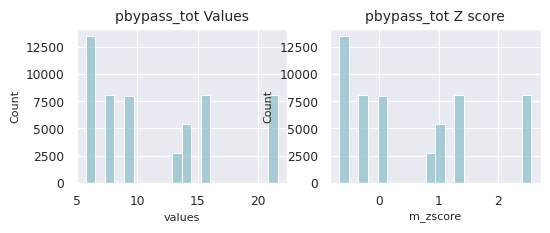

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


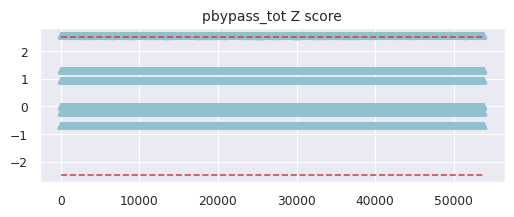

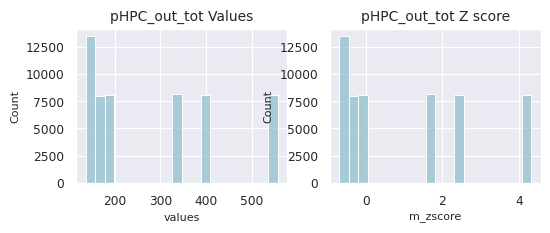

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


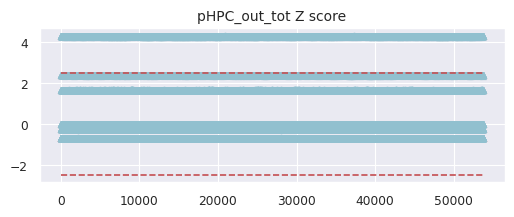

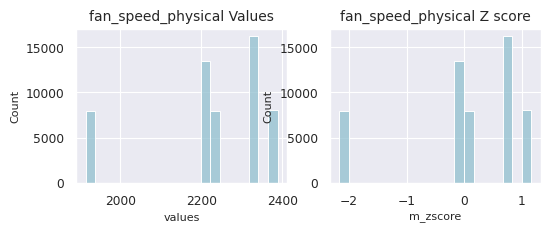

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


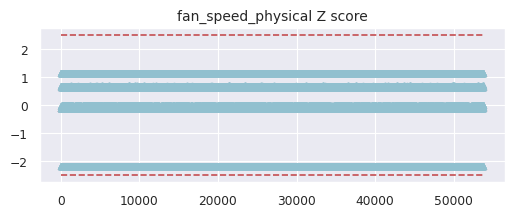

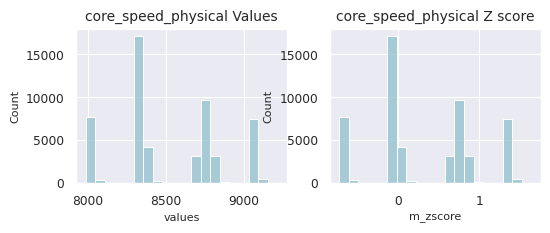

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


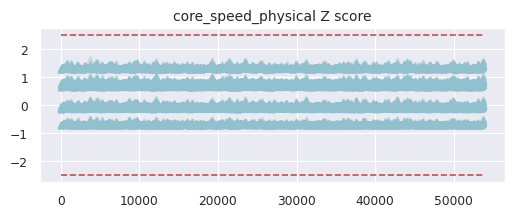

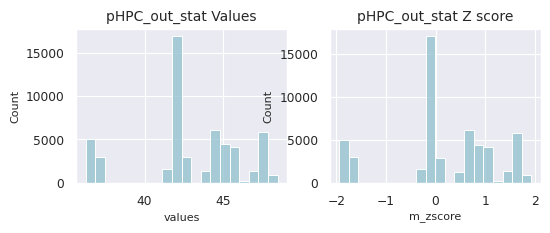

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


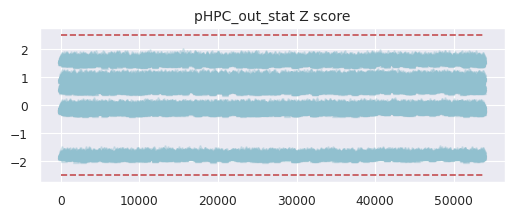

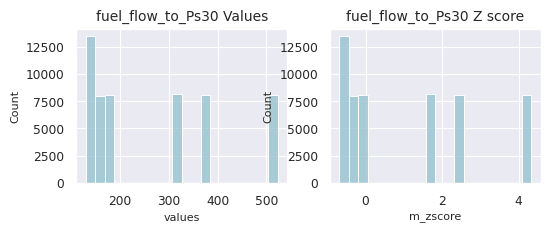

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


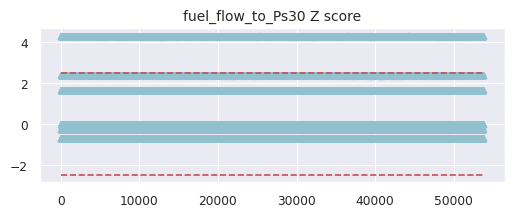

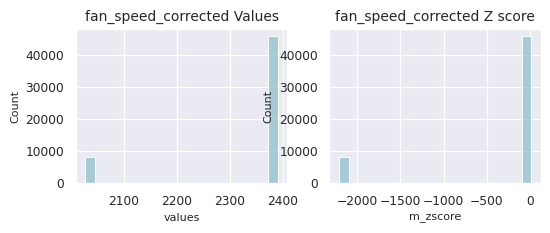

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


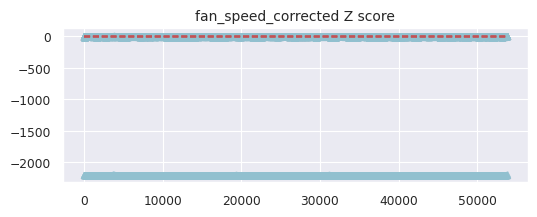

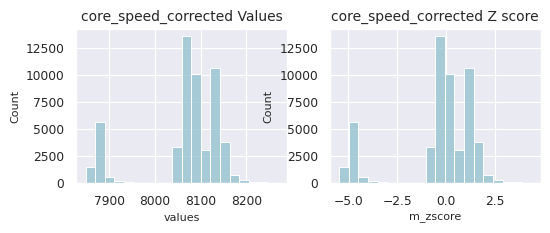

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


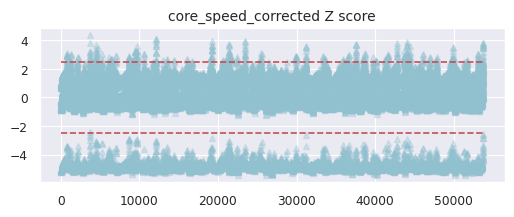

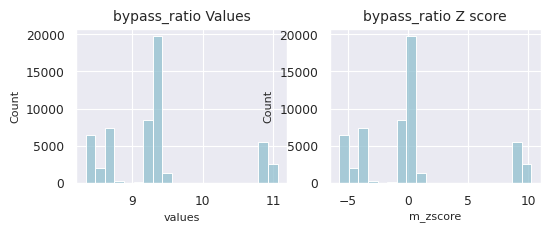

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


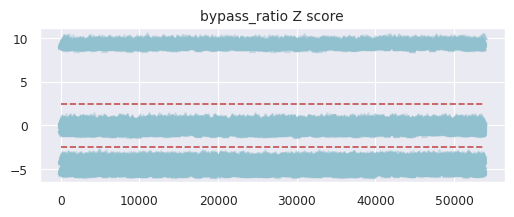

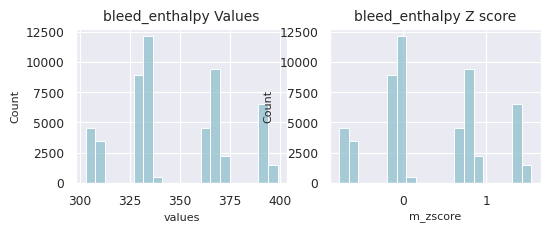

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


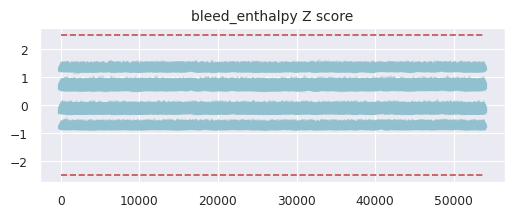

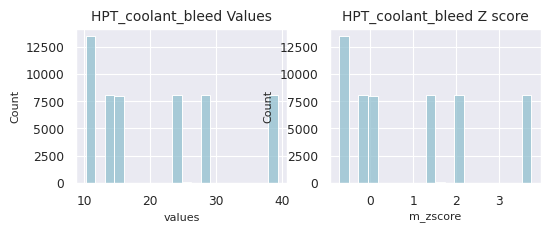

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


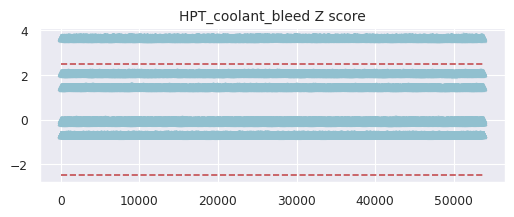

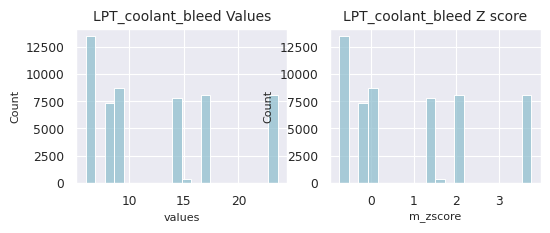

<ipython-input-235-c76f70cfe2a2>:10: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k^" (-> color='k'). The keyword argument will take precedence.
  plt.plot(data,'k^',  c='#91c0cf', alpha=0.3)


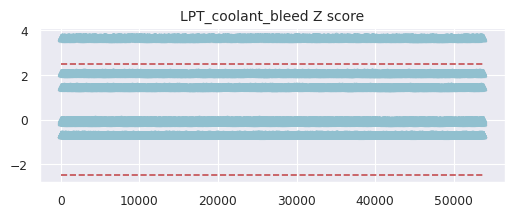

In [ ]:

sensors = ['tLPC_out_tot', 'tHPC_out_tot', 'tLPT_out_tot', 'pbypass_tot',
       'pHPC_out_tot', 'fan_speed_physical', 'core_speed_physical',
       'pHPC_out_stat', 'fuel_flow_to_Ps30', 'fan_speed_corrected',
       'core_speed_corrected', 'bypass_ratio', 'bleed_enthalpy',
       'HPT_coolant_bleed', 'LPT_coolant_bleed']




outliers_all, transformed_all = [], []
for col in engines2[sensors].columns:
    outliers, transformed = modif_zscore(engines2[[col]])
    outliers_all.append(outliers)
    transformed_all.append(transformed)

    sns.set_context("paper", rc={"font.size":2,"axes.titlesize":10,"axes.labelsize":8})
    fig, axes = plt.subplots(1, 2, figsize=(6,2))
    sns.histplot(ax=axes[0], data=transformed, x=transformed['values'], bins=20, color = '#91c0cf').set(title=f'{col} Values')
    sns.histplot(ax=axes[1], data=transformed, x=transformed['m_zscore'], bins=20, color = '#91c0cf').set(title=f'{col} Z score')

    plt.savefig(f"/content/drive/MyDrive/images/{col}hist-z.png",
            bbox_inches ="tight",
            pad_inches = 1,
            transparent = True,
            edgecolor ='w',
            orientation ='landscape')
    plt.show()

    plot_zscore(transformed['m_zscore'].values, d=2.5)
    plt.title(f"{col} Z score")


    plt.savefig(f"/content/drive/MyDrive/images/{col}z.png",
            bbox_inches ="tight",
            pad_inches = 1,
            transparent = True,
            edgecolor ='w',
            orientation ='landscape')

    plt.show()

In [ ]:
# threshold = 2.5
# outliers, transformed = zscore(engines1[['tLPC_out_tot']], threshold)

We make boxplots for each of the variables for the dataset.

# Calculate RUL and Fault

We make a function that calculates and creates a RUL-column to all our training dataset.

In [ ]:
def rul_col_series(df):
    max_cycles = df[['engine_no', 'cycles']].groupby('engine_no').max().values
    max_cycles = [n[0] for n in max_cycles]
    rul_column = []
    for c in max_cycles:
        c_rul = list(range(c, 0, -1))
        for r in c_rul:
            rul_column.append(r -1)
    df['RUL'] = rul_column

Creates the RUL-column for each of the training datasets.

In [ ]:
rul_col_series(engines1)
rul_col_series(engines2)
rul_col_series(engines3)
rul_col_series(engines4)

Add class to dataset 1. Class 1 if engine fault in 5 cycles or less, and class 0 if not.

In [ ]:
def add_health_index(df):
    df_health_index = df.copy()
    df_health_index['health'] = 3
    df_health_index.loc[df_health_index['RUL'] <= 200, 'health'] = 2
    df_health_index.loc[df_health_index['RUL'] <= 125, 'health'] = 1
    df_health_index.loc[df_health_index['RUL'] <= 50, 'health'] = 0
    return df_health_index

In [ ]:
engines1 = add_health_index(engines1)
engines2 = add_health_index(engines2)
engines3 = add_health_index(engines3)
engines4 = add_health_index(engines4)

Find the size of the engine fleet for each of the training dataset.

In [ ]:
engines1 = engines1.dropna()
engines2 = engines2.dropna()
engines3 = engines3.dropna()
engines4 = engines4.dropna()

In [ ]:
index1 = engines1.index.values
index2 = engines2.index.values
index3 = engines3.index.values
index4 = engines4.index.values


# Sample 20 engines from datasets

Draws 20 sample engines from each training dataset.

In [ ]:
max_eng1 = engines1.engine_no.max()
max_eng2 = engines2.engine_no.max()
max_eng3 = engines3.engine_no.max()
max_eng4 = engines4.engine_no.max()

In [ ]:
rnd1 = random.sample(range(1, max_eng1), 20)
rnd2 = random.sample(range(1, max_eng2), 20)
rnd3 = random.sample(range(1, max_eng3), 20)
rnd4 = random.sample(range(1, max_eng4), 20)

Creates new dataframes of sample engines.

In [ ]:
eng_samples1 = engines1[engines1.engine_no.isin(rnd1)]
eng_samples2 = engines2[engines2.engine_no.isin(rnd2)]
eng_samples3 = engines3[engines3.engine_no.isin(rnd3)]
eng_samples4 = engines4[engines4.engine_no.isin(rnd4)]

Pick engine number and rul to use for visualization for all the 4 full training datasets.

In [ ]:
rul_engno1 = engines1[['engine_no', 'RUL']].groupby('engine_no').max().reset_index()
rul_engno2 = engines2[['engine_no', 'RUL']].groupby('engine_no').max().reset_index()
rul_engno3 = engines3[['engine_no', 'RUL']].groupby('engine_no').max().reset_index()
rul_engno4= engines4[['engine_no', 'RUL']].groupby('engine_no').max().reset_index()

In [ ]:
use_columns_boxplot = ['opc1', 'opc2',
       'tLPC_out_tot', 'tHPC_out_tot', 'tLPT_out_tot',
       'pbypass_tot', 'pHPC_out_tot', 'fan_speed_physical',
       'core_speed_physical', 'pHPC_out_stat',
       'fuel_flow_to_Ps30', 'fan_speed_corrected', 'core_speed_corrected',
       'bypass_ratio', 'burnerfuel_air_ratio', 'bleed_enthalpy',
       'HPT_coolant_bleed', 'LPT_coolant_bleed']

# EDA

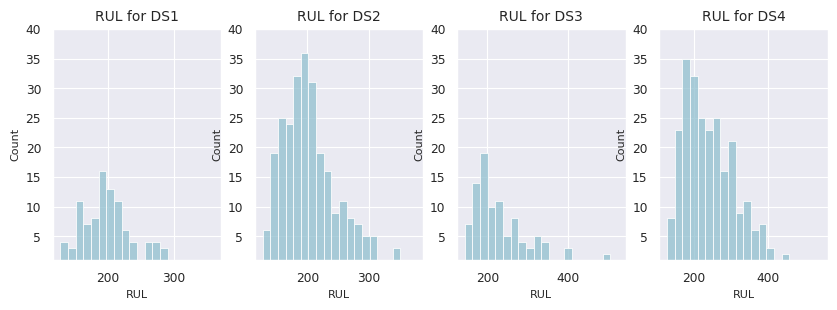

In [ ]:
fig, axes = plt.subplots(1, 4, figsize=(10,3))
sns.histplot(ax=axes[0], data=rul_engno1, x='RUL', bins=20, color = '#91c0cf').set(title='RUL for DS1')
axes[0].set_ylim(1, 40)
sns.histplot(ax=axes[1], data=rul_engno2, x='RUL', bins=20, color = '#91c0cf').set(title='RUL for DS2')
axes[1].set_ylim(1, 40)
sns.histplot(ax=axes[2], data=rul_engno3, x='RUL', bins=20, color = '#91c0cf').set(title='RUL for DS3')
axes[2].set_ylim(1, 40)
sns.histplot(ax=axes[3], data=rul_engno4, x='RUL', bins=20, color = '#91c0cf').set(title='RUL for DS4')
axes[3].set_ylim(1, 40)
plt.savefig("/content/drive/MyDrive/images/rul.png",
            bbox_inches ="tight",
            pad_inches = 1,
            transparent = True,
            edgecolor ='w',
            orientation ='landscape')


In [ ]:
from seaborn.rcmod import axes_style
def plot_1(df, col, ax, save_path):
    for i in rnd1:
        #sns.set(font_scale = 0.8)
        #sns.lineplot(ax=ax, data=df[df.engine_no == i][['rul', col]], x='rul', y=col,  alpha=0.2, color="g")
        sns.lineplot(ax=ax, data=df[df.engine_no == i], x='RUL', y=col,  alpha=0.5, color="#91c0cf")
    ax.invert_xaxis()
        #plt.show()
    plt.savefig(save_path,
              bbox_inches ="tight",
              pad_inches = 1,
              transparent = True,
              edgecolor ='w',
              orientation ='landscape')





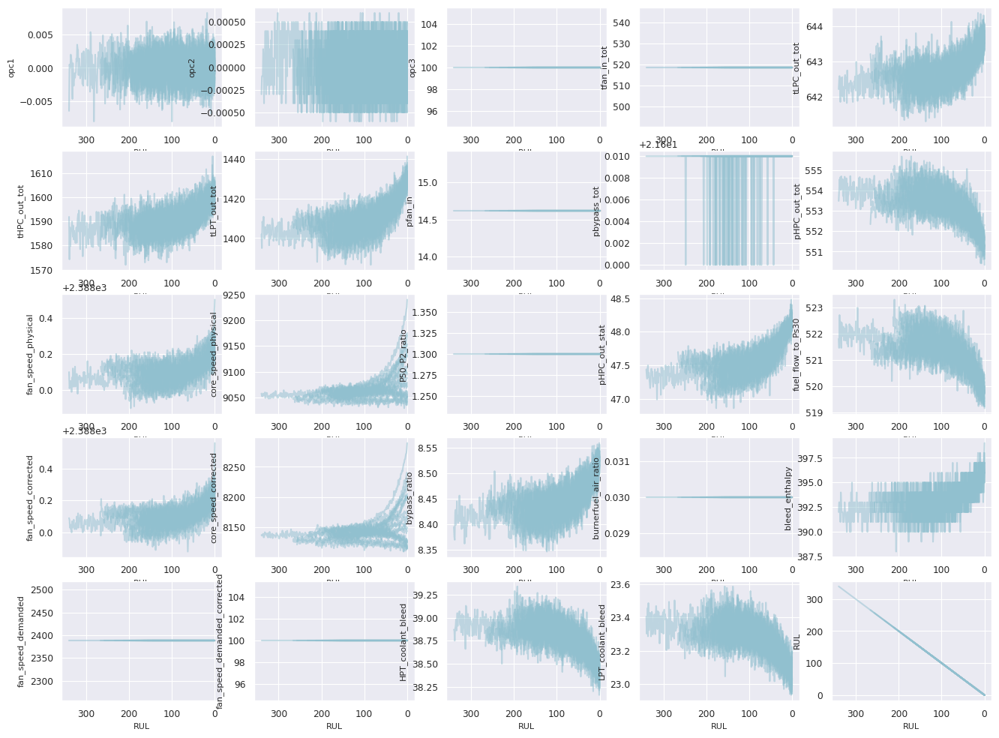

In [ ]:
fig, axis = plt.subplots(5, 5, figsize=(16,12))


# split columns into sets columns to visualize in loop
c_sets = []
for c in range(2, len(eng_samples1.columns),5):
  start = c
  end = c + 5
  c_sets.append(eng_samples1.columns[start:end])



# visualize
for ax, sets  in zip(axis, c_sets):
  for a, s in zip(ax, sets):
    sns.set(font_scale = 0.8)
    plot_1(eng_samples1, s, ax=a, save_path="/content/drive/MyDrive/images/vars1.png")


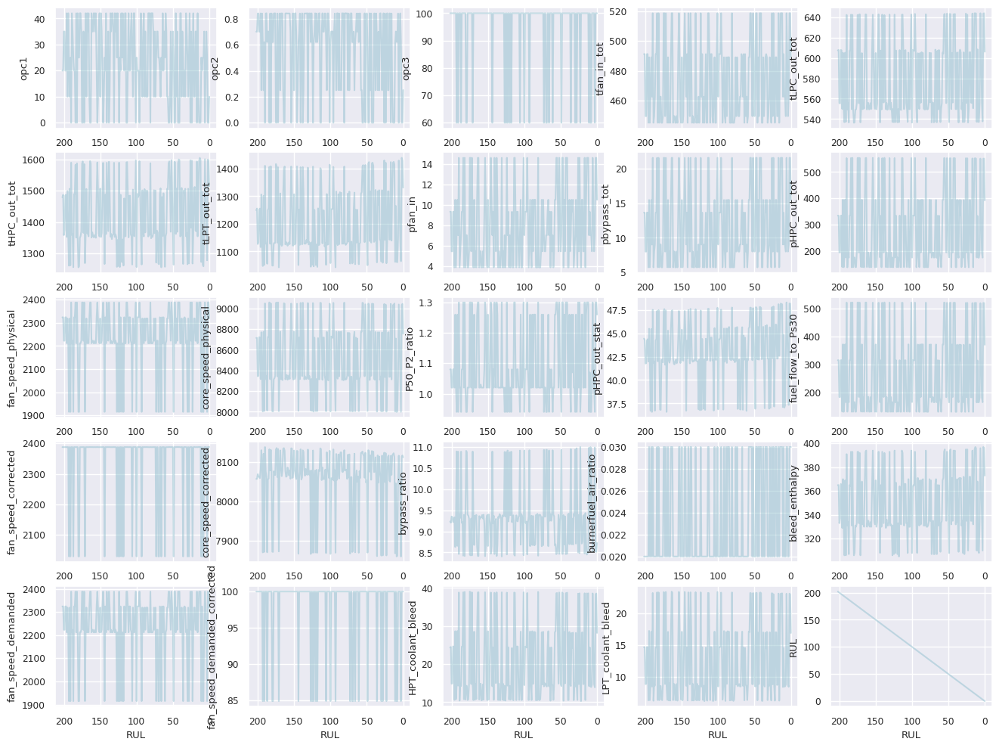

In [ ]:
fig, axis1 = plt.subplots(5, 5, figsize=(16,12))


# split columns into sets columns to visualize in loop
c_sets2 = []
for c in range(2, len(eng_samples2.columns),5):
  start = c
  end = c + 5
  c_sets2.append(eng_samples2.columns[start:end])



# visualize
for ax, sets  in zip(axis1, c_sets2):
  for a, s in zip(ax, sets):
    sns.set(font_scale = 0.8)
    plot_1(eng_samples2, s, ax=a, save_path="/content/drive/MyDrive/images/vars2.png")



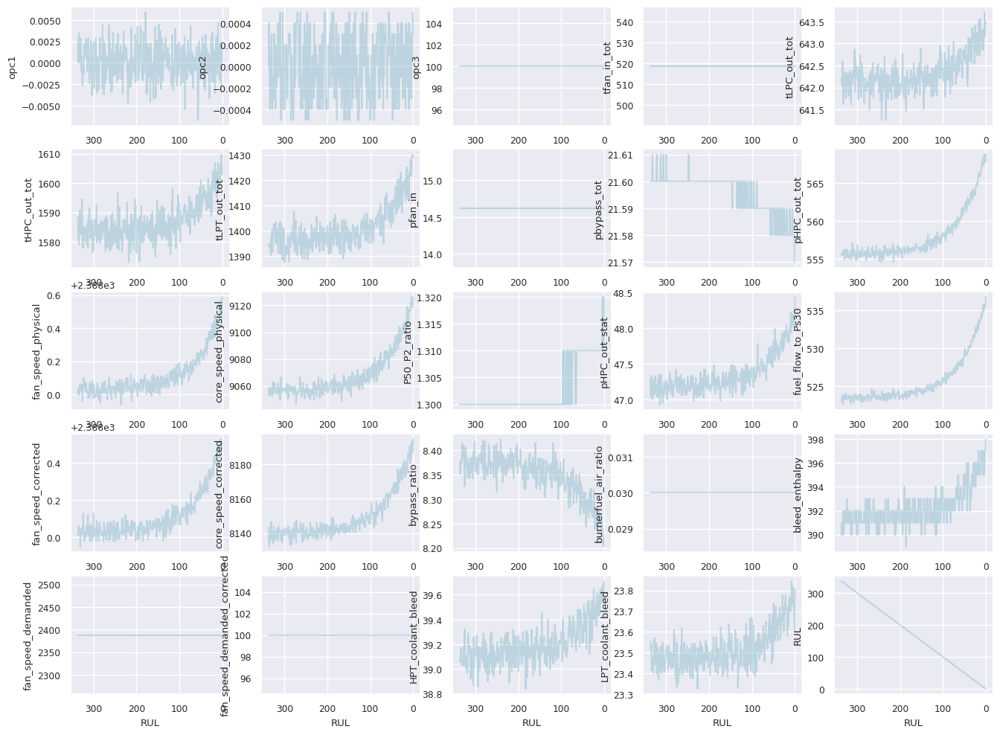

In [ ]:
fig, axis3 = plt.subplots(5, 5, figsize=(16,12))


# split columns into sets columns to visualize in loop
c_sets3 = []
for c in range(2, len(eng_samples3.columns),5):
  start = c
  end = c + 5
  c_sets3.append(eng_samples3.columns[start:end])



# visualize
for ax, sets  in zip(axis3, c_sets3):
  for a, s in zip(ax, sets):
    sns.set(font_scale = 0.8)
    plot_1(eng_samples3, s, ax=a, save_path="/content/drive/MyDrive/images/vars3.png")



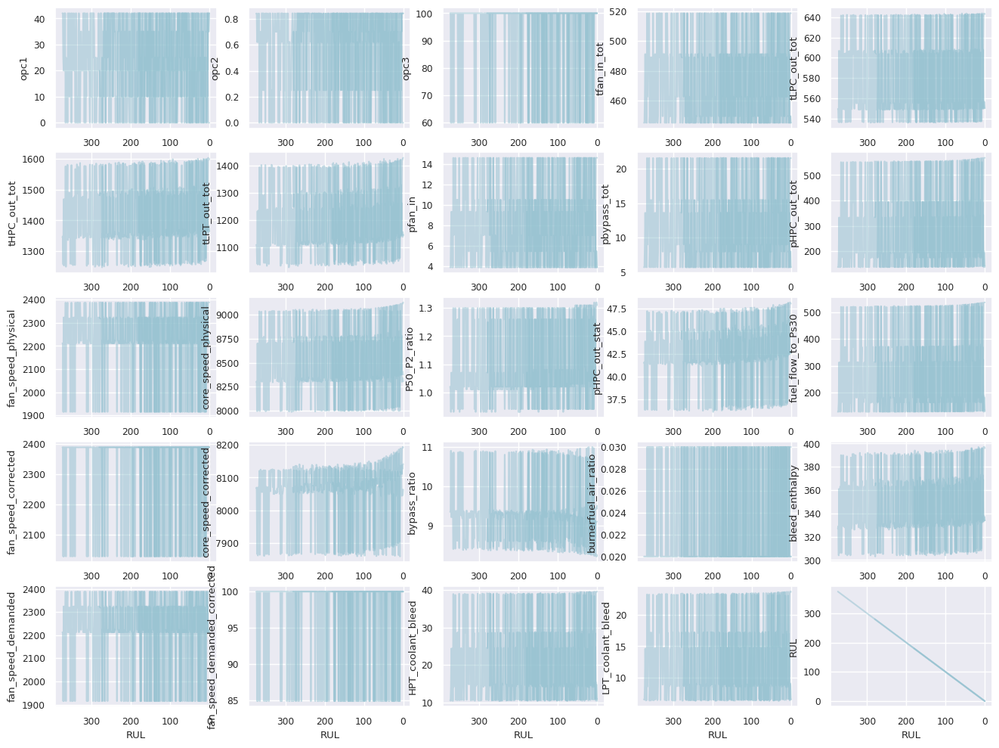

In [ ]:
fig, axis4 = plt.subplots(5, 5, figsize=(16,12))


# split columns into sets columns to visualize in loop
c_sets4 = []
for c in range(2, len(eng_samples4.columns),5):
  start = c
  end = c + 5
  c_sets4.append(eng_samples4.columns[start:end])



# visualize
for ax, sets  in zip(axis4, c_sets4):
  for a, s in zip(ax, sets):
    sns.set(font_scale = 0.8)
    plot_1(eng_samples4, s, ax=a, save_path="/content/drive/MyDrive/images/vars4.png")



## Operating conditions

In [ ]:
def add_operating_condition(df):
    df_op_cond = df.copy()

    df_op_cond['opc1'] = abs(df_op_cond['opc1'].round())
    df_op_cond['opc2'] = abs(df_op_cond['opc2'].round(decimals=2))

    # converting settings to string and concatanating makes the operating condition into a categorical variable
    df_op_cond['op_cond'] = df_op_cond['opc1'].astype(str) + '_' + \
                        df_op_cond['opc2'].astype(str) + '_' + \
                        df_op_cond['opc3'].astype(str)
    return df_op_cond

In [ ]:
engines1 = add_operating_condition(engines1)
engines2 = add_operating_condition(engines2)
engines3 = add_operating_condition(engines3)
engines4 = add_operating_condition(engines4)

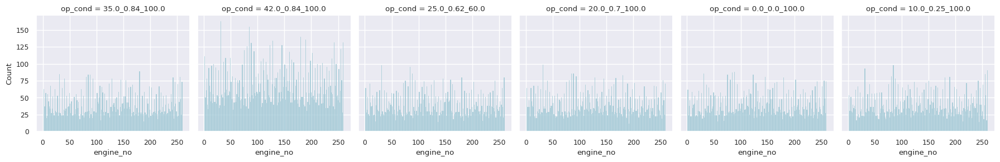

In [ ]:



g = sns.FacetGrid(engines2,  col="op_cond")
g.map_dataframe(sns.histplot,bins=200, x="engine_no", color="#91c0cf")

plt.savefig("/content/drive/MyDrive/images/opcond2.png",
            bbox_inches ="tight",
            pad_inches = 1,
            transparent = True,
            edgecolor ='w',
            orientation ='landscape')


In [ ]:
engines_test1 = add_operating_condition(base_test1)
engines_test2 = add_operating_condition(base_test2)
engines_test3 = add_operating_condition(base_test3)
engines_test4 = add_operating_condition(base_test4)

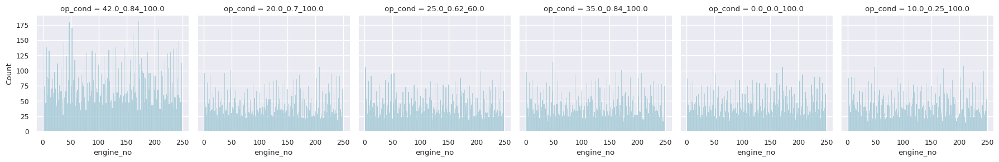

In [ ]:
g = sns.FacetGrid(engines4, col="op_cond")
g.map_dataframe(sns.histplot, x="engine_no", bins=200, color="#91c0cf")
plt.savefig("/content/drive/MyDrive/images/opcond4.png",
            bbox_inches ="tight",
            pad_inches = 1,
            transparent = True,
            edgecolor ='w',
            orientation ='landscape')


In [ ]:
sensors = ['tLPC_out_tot', 'tHPC_out_tot', 'tLPT_out_tot', 'pbypass_tot',
       'pHPC_out_tot', 'fan_speed_physical', 'core_speed_physical',
       'pHPC_out_stat', 'fuel_flow_to_Ps30', 'fan_speed_corrected',
       'core_speed_corrected', 'bypass_ratio', 'bleed_enthalpy',
       'HPT_coolant_bleed', 'LPT_coolant_bleed', 'RUL']
sns.pairplot(eng_samples1[sensors], hue='RUL', palette='viridis', kind='hist')

In [ ]:
sns.pairplot(eng_samples2[sensors], hue='RUL', palette='viridis', kind='hist')

In [ ]:
sns.pairplot(eng_samples3[sensors], hue='RUL', palette='viridis', kind='hist')

In [ ]:
sns.pairplot(eng_samples4[sensors], hue='RUL', palette='viridis', kind='hist')

# Correlations

We make the calculation of correlation matrix.

<ipython-input-272-2f75b7f64bc6>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = engines1.corr()


<Axes: >

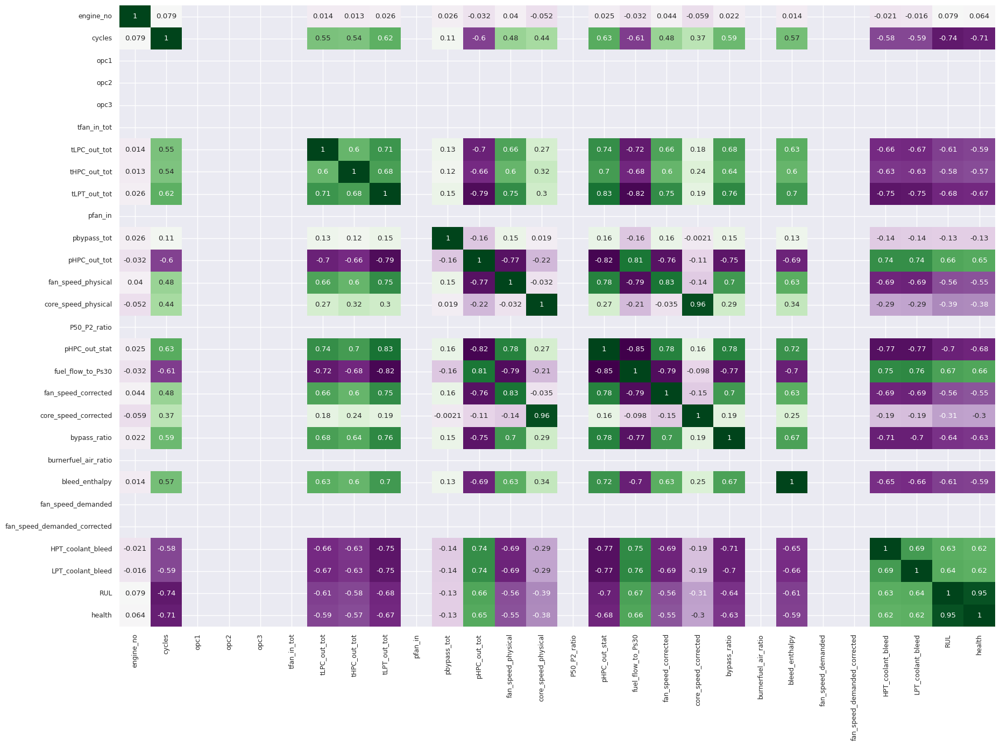

In [ ]:
plt.figure(figsize=(21,15))
corr = engines1.corr()
# corr.style.background_gradient(cmap='YlGnBu')

sns.heatmap(corr,cmap='PRGn',annot=True, cbar=False)

In [ ]:
cor_target = abs(corr['RUL'])
cor_target[cor_target > 0.5].index

Index(['cycles', 'tLPC_out_tot', 'tHPC_out_tot', 'tLPT_out_tot',
       'pHPC_out_tot', 'fan_speed_physical', 'pHPC_out_stat',
       'fuel_flow_to_Ps30', 'fan_speed_corrected', 'bypass_ratio',
       'bleed_enthalpy', 'HPT_coolant_bleed', 'LPT_coolant_bleed', 'RUL',
       'health'],
      dtype='object')

In [ ]:
cor_target[cor_target > 0.6].sort_values(ascending=False).index

Index(['RUL', 'health', 'cycles', 'pHPC_out_stat', 'tLPT_out_tot',
       'fuel_flow_to_Ps30', 'pHPC_out_tot', 'bypass_ratio',
       'LPT_coolant_bleed', 'HPT_coolant_bleed', 'tLPC_out_tot',
       'bleed_enthalpy'],
      dtype='object')

<ipython-input-275-bc91be12afa2>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr2 = engines2.corr()


<Axes: >

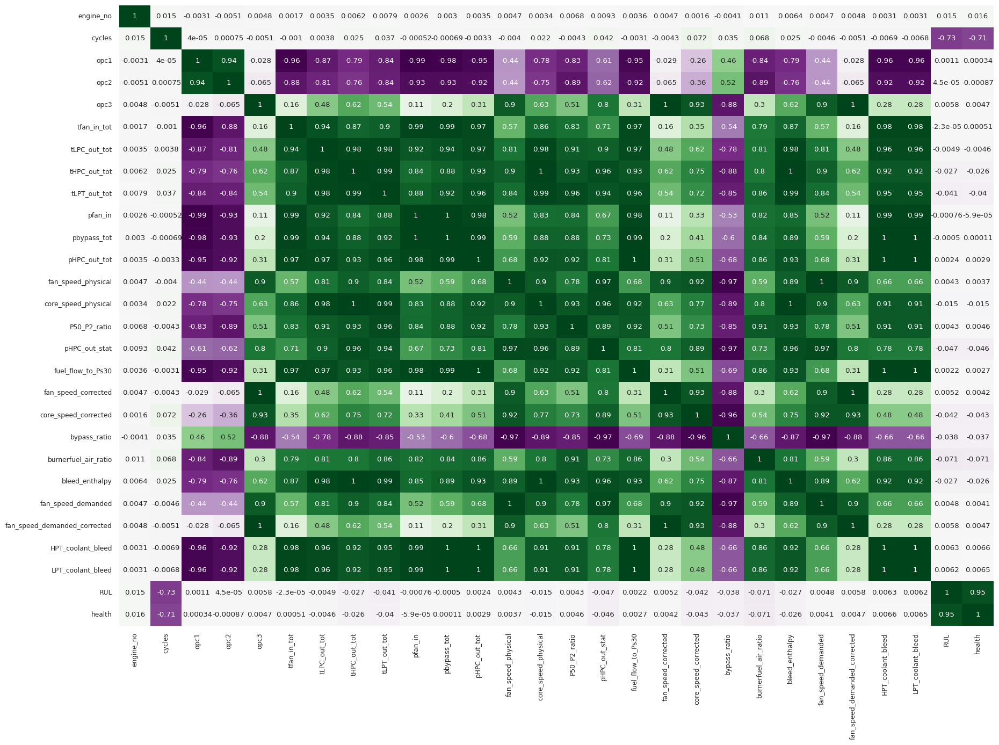

In [ ]:
plt.figure(figsize=(21,15))
corr2 = engines2.corr()
# corr.style.background_gradient(cmap='YlGnBu')
sns.heatmap(corr2,cmap='PRGn',annot=True, cbar=False)

In [ ]:
cor_target2 = abs(corr2['RUL'])
cor_target2[cor_target2 > 0.3]

cycles    0.733383
RUL       1.000000
health    0.948382
Name: RUL, dtype: float64

<ipython-input-277-bc41654a57e3>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr3 = engines3.corr()


<Axes: >

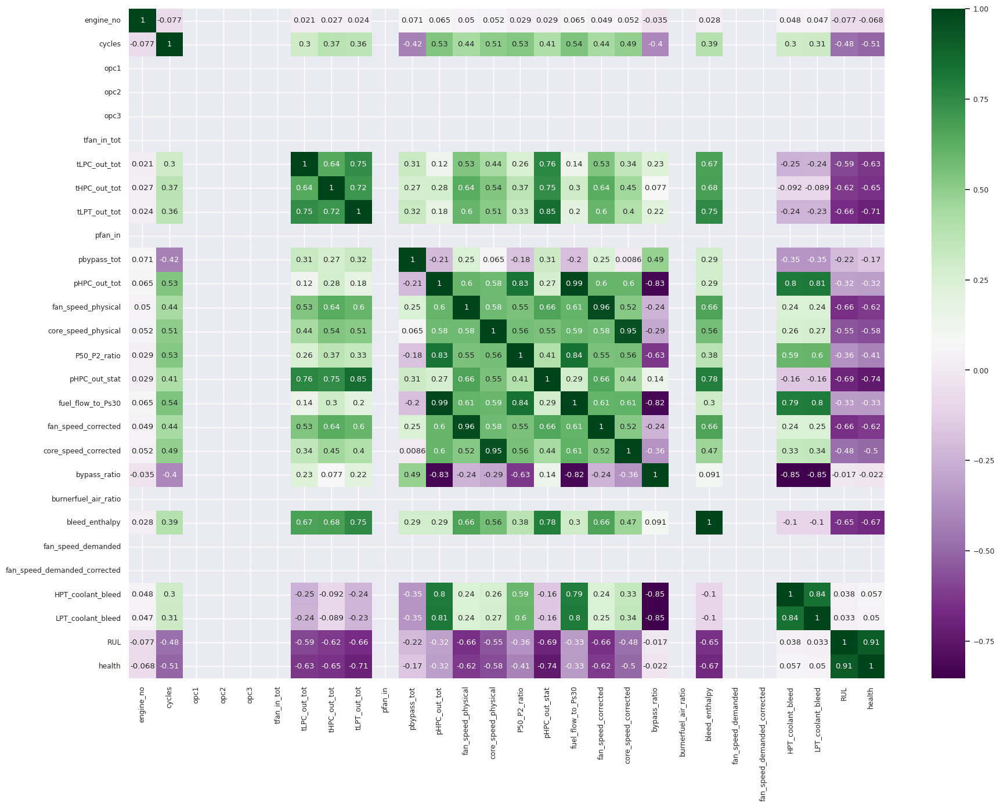

In [ ]:
plt.figure(figsize=(21,15))
corr3 = engines3.corr()
# corr.style.background_gradient(cmap='PRGn')
sns.heatmap(corr3,cmap='PRGn',annot=True)

In [ ]:
cor_target3 = abs(corr3['RUL'])
cor_target3[cor_target3 > 0.3]

cycles                  0.482744
tLPC_out_tot            0.590564
tHPC_out_tot            0.624236
tLPT_out_tot            0.657224
pHPC_out_tot            0.315048
fan_speed_physical      0.655345
core_speed_physical     0.551843
P50_P2_ratio            0.363432
pHPC_out_stat           0.688915
fuel_flow_to_Ps30       0.329452
fan_speed_corrected     0.656340
core_speed_corrected    0.481807
bleed_enthalpy          0.649220
RUL                     1.000000
health                  0.907718
Name: RUL, dtype: float64

<ipython-input-279-93e3888bf3f6>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr4 = engines4.corr()


<Axes: >

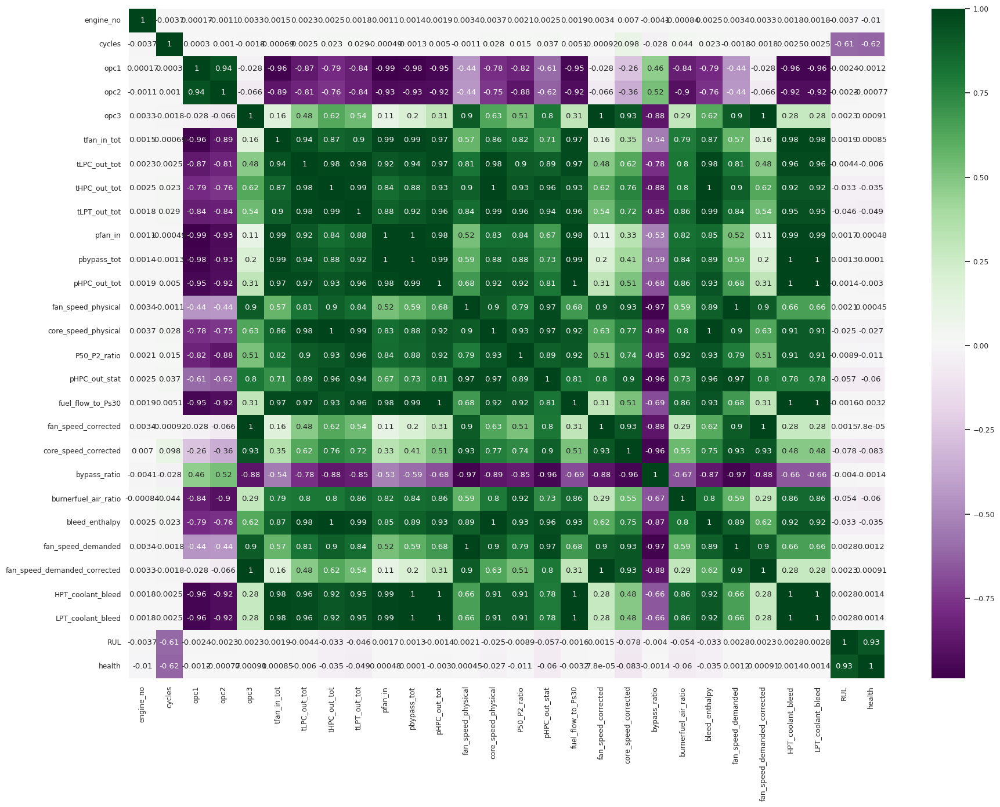

In [ ]:
plt.figure(figsize=(21,15))
corr4 = engines4.corr()
# corr.style.background_gradient(cmap='YlGnBu')
sns.heatmap(corr4,cmap='PRGn',annot=True)

In [ ]:
cor_target4 = abs(corr4['RUL'])
cor_target4[cor_target4 > 0.3]

cycles    0.610620
RUL       1.000000
health    0.929722
Name: RUL, dtype: float64

In [ ]:
def condition_scaler(df_train, df_test, sensor_names):
    # apply operating condition specific scaling

    for condition in df_train['op_cond'].unique():
        scaler = StandardScaler()
        scaler.fit(df_train.loc[df_train['op_cond']==condition, sensor_names])
        df_train.loc[df_train['op_cond']==condition, sensor_names] = scaler.transform(df_train.loc[df_train['op_cond']==condition, sensor_names])
        df_test.loc[df_test['op_cond']==condition, sensor_names] = scaler.transform(df_test.loc[df_test['op_cond']==condition, sensor_names])
    return df_train, df_test

In [ ]:
sensor_names  = ["tfan_in_tot", "tLPC_out_tot", "tHPC_out_tot",
           "tLPT_out_tot", "pfan_in", "pbypass_tot", "pHPC_out_tot", "fan_speed_physical", "core_speed_physical",
           "P50_P2_ratio", "pHPC_out_stat", "fuel_flow_to_Ps30", "fan_speed_corrected", "core_speed_corrected",
           "bypass_ratio", "burnerfuel_air_ratio", "bleed_enthalpy", "fan_speed_demanded", "fan_speed_demanded_corrected" ,
           "HPT_coolant_bleed", "LPT_coolant_bleed"]


In [ ]:
# Columns with labels.
settings = ['opc1', 'opc2', 'opc3']

# Column with target
target = ['RUL']

We create X_train_regr1

# Scale data

## Dataset 1

In [ ]:

X_train_regr1s, X_test_regr1s = condition_scaler(engines1, engines_test1, sensor_names)

X_train_regr1s = pd.DataFrame(X_train_regr1s, columns = engines1.columns)
X_test_regr1s = pd.DataFrame(X_test_regr1s, columns = engines1.columns)
y_train_regr1 = engines1['RUL']

## Dataset 2

For dataset 2, 4, need to check the columns to remove, because it doesn't do well removing the same as in ds 1, 3  or not removing at all


In [ ]:

X_train_regr2s, X_test_regr2s = condition_scaler(engines2, engines_test2, sensor_names)

X_train_regr2s = pd.DataFrame(X_train_regr2s, columns = engines2.columns)
X_test_regr2s = pd.DataFrame(X_test_regr2s, columns = engines2.columns)
y_train_regr2 = engines2['RUL']


## Dataset 3

In [ ]:
X_train_regr3 = engines3
X_test_regr3 = base_test3

X_train_regr3s, X_test_regr3s = condition_scaler(engines3, engines_test3, sensor_names)

X_train_regr3s = pd.DataFrame(X_train_regr3s, columns = engines3.columns)
X_test_regr3s = pd.DataFrame(X_test_regr3s, columns = engines3.columns)

y_train_regr3 = engines3['RUL']

## Dataset 4

In [ ]:
X_train_regr4s, X_test_regr4s = condition_scaler(engines4, engines_test4, sensor_names)

X_train_regr4s = pd.DataFrame(X_train_regr4s, columns = engines4.columns)
X_test_regr4s = pd.DataFrame(X_test_regr4s, columns = engines4.columns)

y_train_regr4 = engines4['RUL']

# Feature selection

## Univariate feature selection

In [ ]:
# data readout
sensor_names  = ["tfan_in_tot", "tLPC_out_tot", "tHPC_out_tot",
           "tLPT_out_tot", "pfan_in", "pbypass_tot", "pHPC_out_tot", "fan_speed_physical", "core_speed_physical",
           "P50_P2_ratio", "pHPC_out_stat", "fuel_flow_to_Ps30", "fan_speed_corrected", "core_speed_corrected",
           "bypass_ratio", "burnerfuel_air_ratio", "bleed_enthalpy", "fan_speed_demanded", "fan_speed_demanded_corrected" ,
           "HPT_coolant_bleed", "LPT_coolant_bleed"]

In [ ]:
from sklearn.feature_selection import f_regression, SelectKBest

fs = SelectKBest(score_func=f_regression, k=15).fit(X_train_regr1s[sensor_names], y_train_regr1)

# Get the score and select features
scores1 = fs.scores_
selected_feat = X_train_regr1s[sensor_names].columns[fs.get_support()]



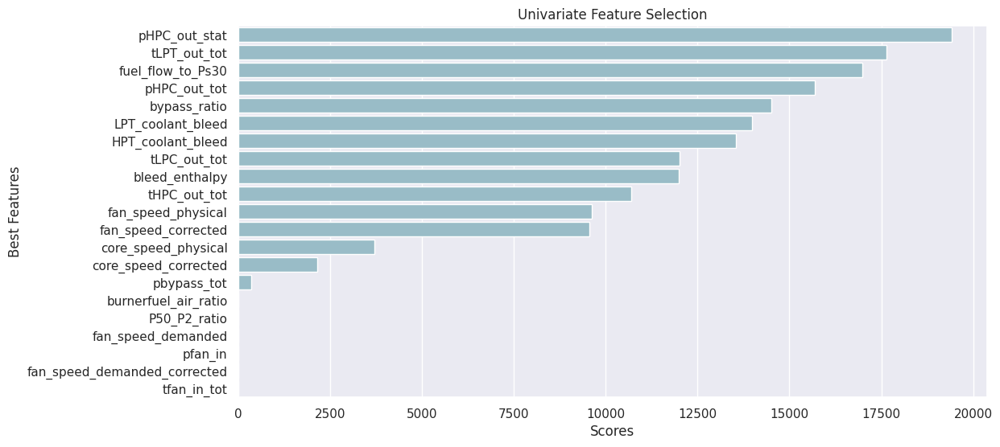

In [ ]:
plt.figure(figsize=(12, 6))
sns.barplot(x=scores1[np.argsort(scores1)[::-1]], y=np.array(X_train_regr1s[sensor_names].columns)[np.argsort(scores1)[::-1]],
            color="#91c0cf")
plt.xlabel('Scores')
plt.ylabel('Best Features')
plt.title('Univariate Feature Selection')
plt.show()

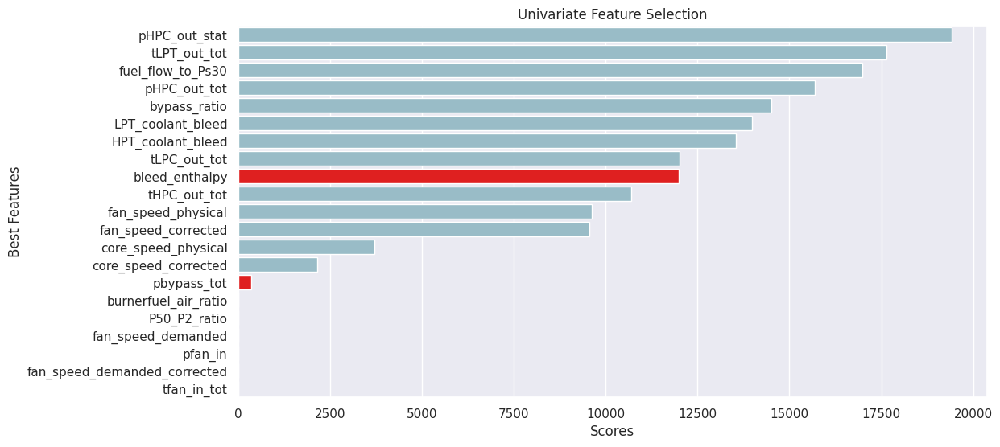

In [ ]:
plt.figure(figsize=(12, 6))


cols = ['tLPC_out_tot', 'tHPC_out_tot', 'tLPT_out_tot', 'pHPC_out_tot',
       'fan_speed_physical', 'core_speed_physical', 'pHPC_out_stat',
       'fuel_flow_to_Ps30', 'fan_speed_corrected', 'core_speed_corrected',
       'bypass_ratio', 'HPT_coolant_bleed', 'LPT_coolant_bleed']

clrs = ["#91c0cf", "#91c0cf", "#91c0cf", "#91c0cf", "#91c0cf", "#91c0cf", "#91c0cf", "#91c0cf", "red", "#91c0cf", "#91c0cf", "#91c0cf","#91c0cf", "#91c0cf", "red" ]
sns.barplot(x=scores1[np.argsort(scores1)[::-1]], y=np.array(X_train_regr1s[sensor_names].columns)[np.argsort(scores1)[::-1]],
            palette=clrs)
plt.xlabel('Scores')
plt.ylabel('Best Features')
plt.title('Univariate Feature Selection')
plt.show()

In [ ]:
fs2 = SelectKBest(score_func=f_regression, k=15).fit(X_train_regr2s[sensor_names], y_train_regr2)

# Get the score and select features
scores2 = fs2.scores_
selected_feat2 = X_train_regr2s[sensor_names].columns[fs2.get_support()]

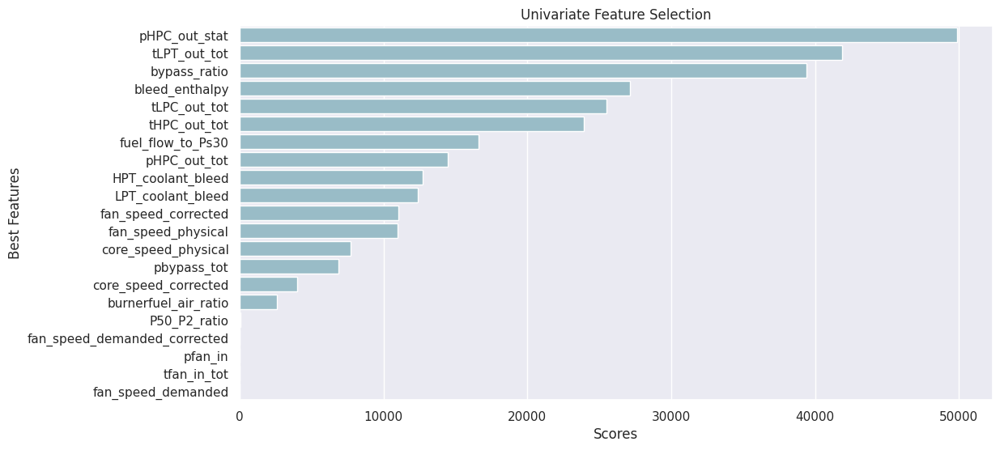

In [ ]:
plt.figure(figsize=(12, 6))
sns.barplot(x=scores2[np.argsort(scores2)[::-1]], y=np.array(X_train_regr2s[sensor_names].columns)[np.argsort(scores2)[::-1]], color='#91c0cf')
plt.xlabel('Scores')
plt.ylabel('Best Features')
plt.title('Univariate Feature Selection')
plt.show()

In [ ]:
fs3 = SelectKBest(score_func=f_regression, k=15).fit(X_train_regr3s[sensor_names], y_train_regr3)

# Get the score and select features
scores3 = fs3.scores_
selected_feat3 = X_train_regr3s[sensor_names].columns[fs3.get_support()]

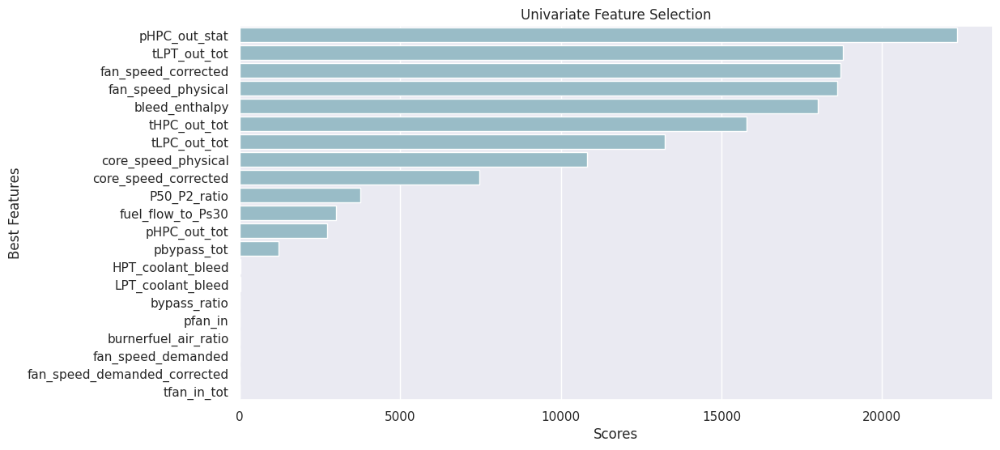

In [ ]:
plt.figure(figsize=(12, 6))
sns.barplot(x=scores3[np.argsort(scores3)[::-1]], y=np.array(X_train_regr3s[sensor_names].columns)[np.argsort(scores3)[::-1]],
            color='#91c0cf')
plt.xlabel('Scores')
plt.ylabel('Best Features')
plt.title('Univariate Feature Selection')
plt.show()

In [ ]:
fs4 = SelectKBest(score_func=f_regression, k=15).fit(X_train_regr4s[sensor_names], y_train_regr4)

# Get the score and select features
scores4 = fs4.scores_
selected_feat4 = X_train_regr4s[sensor_names].columns[fs4.get_support()]

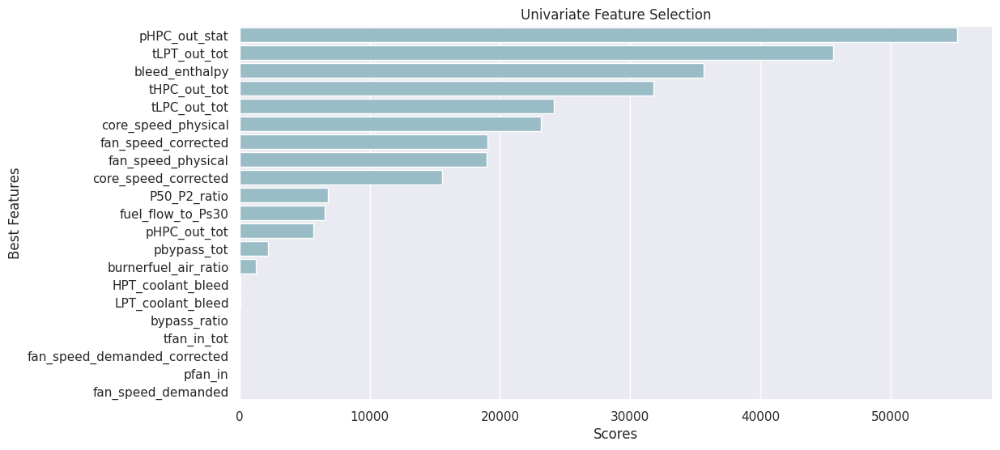

In [ ]:
plt.figure(figsize=(12, 6))
sns.barplot(x=scores4[np.argsort(scores4)[::-1]], y=np.array(X_train_regr4s[sensor_names].columns)[np.argsort(scores4)[::-1]], color='#91c0cf')
plt.xlabel('Scores')
plt.ylabel('Best Features')
plt.title('Univariate Feature Selection')
plt.show()

## Boruta




In [ ]:
!pip install boruta

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.6/56.6 kB 867.3 kB/s eta 0:00:00


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from boruta import BorutaPy
forest_reg1 = RandomForestRegressor(max_depth = 5)
feat_selector = BorutaPy(forest_reg1, n_estimators='auto', verbose=2, random_state=1)#

In [ ]:

feat_selector.fit(np.array(X_train_regr1s[sensor_names]), np.array(y_train_regr1))

Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	21
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	21
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	21
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	21
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	21
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	21
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	21
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	13
Tentative: 	1
Rejected: 	7
Iteration: 	9 / 100
Confirmed: 	13
Tentative: 	1
Rejected: 	7
Iteration: 	10 / 100
Confirmed: 	13
Tentative: 	1
Rejected: 	7
Iteration: 	11 / 100
Confirmed: 	13
Tentative: 	1
Rejected: 	7
Iteration: 	12 / 100
Confirmed: 	13
Tentative: 	1
Rejected: 	7
Iteration: 	13 / 100
Confirmed: 	13
Tentative: 	1
Rejected: 	7
Iteration: 	14 / 100
Confirmed: 	13
Tentative: 	1
Rejected: 	7
Iteration: 	15 / 100
Confirmed: 	13
Tentative: 	1
Rejected: 	7
Iteration: 	16 / 100
Confirmed: 	13
Tentative: 	1
Rejected: 	7
I

BorutaPy(estimator=RandomForestRegressor(max_depth=5, n_estimators=105,
                                         random_state=RandomState(MT19937) at 0x7B9F11B74040),
         n_estimators='auto',
         random_state=RandomState(MT19937) at 0x7B9F11B74040, verbose=2)

In [ ]:
feat_selector.support_

array([False,  True,  True,  True, False, False,  True,  True,  True,
       False,  True,  True,  True,  True,  True, False, False, False,
       False,  True,  True])

In [ ]:
feat_selector.ranking_

array([3, 1, 1, 1, 3, 3, 1, 1, 1, 3, 1, 1, 1, 1, 1, 3, 2, 3, 3, 1, 1])

In [ ]:
feat_df = pd.DataFrame(X_train_regr1s[sensor_names].columns.to_list(), columns=['features'])
feat_df['ranking'] = feat_selector.ranking_

In [ ]:
feat_df[feat_df.ranking==1]['features'].values

array(['tLPC_out_tot', 'tHPC_out_tot', 'tLPT_out_tot', 'pHPC_out_tot',
       'fan_speed_physical', 'core_speed_physical', 'pHPC_out_stat',
       'fuel_flow_to_Ps30', 'fan_speed_corrected', 'core_speed_corrected',
       'bypass_ratio', 'HPT_coolant_bleed', 'LPT_coolant_bleed'],
      dtype=object)

In [ ]:
print(feat_df)

                        features  ranking
0                    tfan_in_tot        3
1                   tLPC_out_tot        1
2                   tHPC_out_tot        1
3                   tLPT_out_tot        1
4                        pfan_in        3
5                    pbypass_tot        3
6                   pHPC_out_tot        1
7             fan_speed_physical        1
8            core_speed_physical        1
9                   P50_P2_ratio        3
10                 pHPC_out_stat        1
11             fuel_flow_to_Ps30        1
12           fan_speed_corrected        1
13          core_speed_corrected        1
14                  bypass_ratio        1
15          burnerfuel_air_ratio        3
16                bleed_enthalpy        2
17            fan_speed_demanded        3
18  fan_speed_demanded_corrected        3
19             HPT_coolant_bleed        1
20             LPT_coolant_bleed        1


## Recursive feature elimination

Recursive Feature Elimination (RFE)

In [ ]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression

# # We are creating a Linear regressor.
# model_regr1 =LinearRegression()

# # We are applying RFE.
# rfe1 = RFE(estimator=model_regr1, n_features_to_select = 12)
# rfe1 = rfe1.fit(X_train_regr1_s, y_train_regr1)
# X_train_regr1_new = rfe1.transform(X_train_regr1_s)

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFE

# We are creating a Random Forest Classifier.
rf = RandomForestClassifier(max_depth=6)

# We are applying recursive feature elimination.
feat_selector = RFE(rf, n_features_to_select=15)
feat_selector = feat_selector.fit(X_train_regr1s[sensor_names], y_train_regr1)
X_train_new = feat_selector.transform(X_train_regr1s[sensor_names])

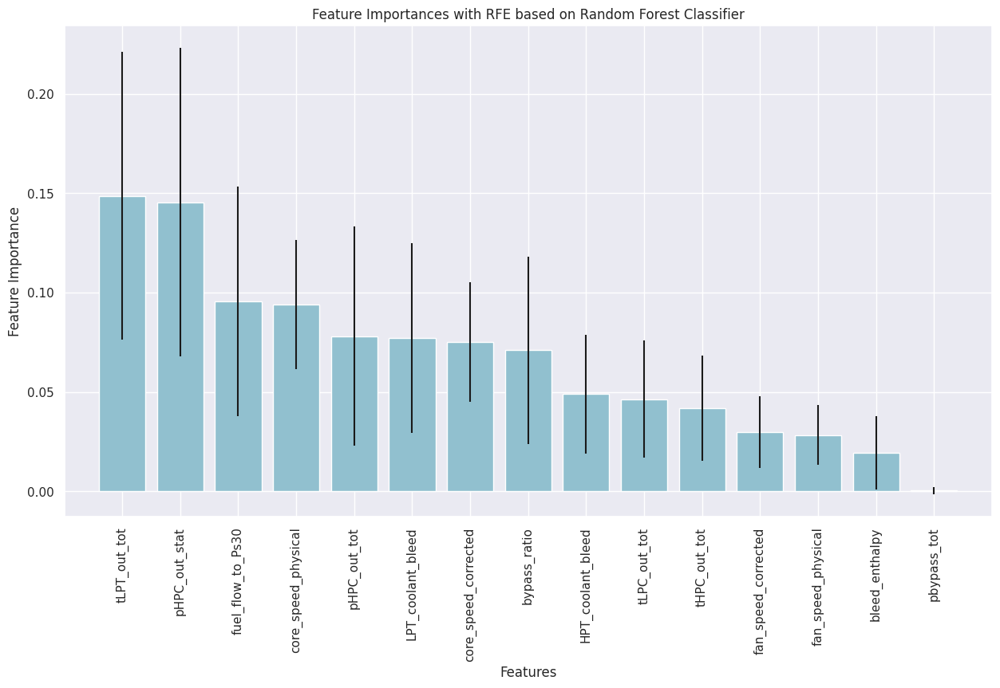

In [ ]:
# Plot feature importances
feat_importances = feat_selector.estimator_.feature_importances_
std = np.std([tree.feature_importances_ for tree in feat_selector.estimator_.estimators_], axis=0)
idxs = np.argsort(feat_importances)[::-1]

plt.figure(figsize=(15, 8))
plt.bar(range(X_train_new.shape[1]), feat_importances[idxs], color='#91c0cf', yerr=std[idxs], align="center")
plt.xticks(range(X_train_new.shape[1]), X_train_regr1s[sensor_names].columns[feat_selector.get_support()][idxs], rotation=90)
plt.xlim([-1, X_train_new.shape[1]])
plt.ylabel('Feature Importance')
plt.xlabel('Features')
plt.title('Feature Importances with RFE based on Random Forest Classifier')
plt.show()

# Cluster

### Cluster predicts three components

(array([0, 1, 2]), array([  912, 11191, 12617]))

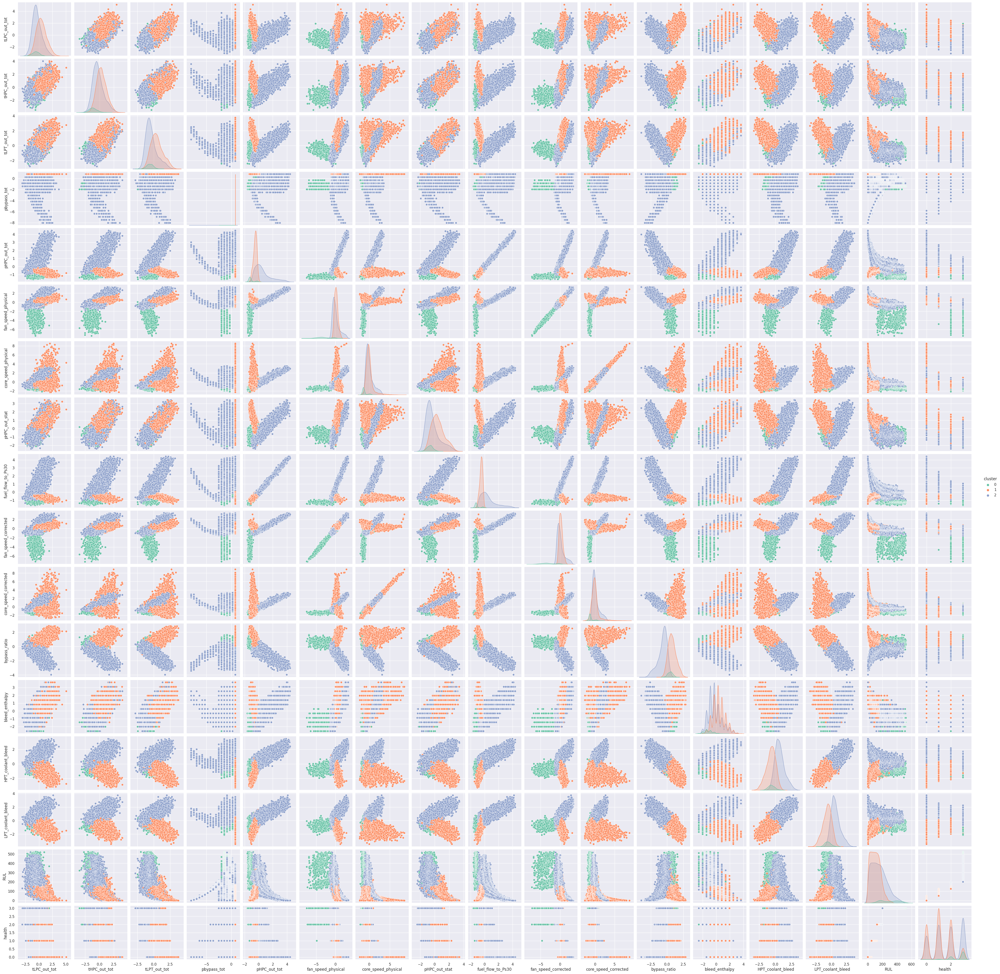

In [ ]:
x_gmm3 = X_train_regr3s.copy()
gmm3 = GaussianMixture(n_components = 3)

# Fit the GMM model for the dataset
# which expresses the dataset as a
# mixture of 3 Gaussian Distribution
gmm3.fit(x_gmm3[sensors])
x_gmm3['cluster'] = gmm3.predict(x_gmm3[sensors])


sns.pairplot(x_gmm3[sensors + ['cluster', 'RUL', 'health']], hue='cluster', palette='Set2')
np.unique(gmm3.predict(x_gmm3[sensors ]), return_counts=True)



### Cluster predicts 2 components

(array([0, 1]), array([29598, 31651]))

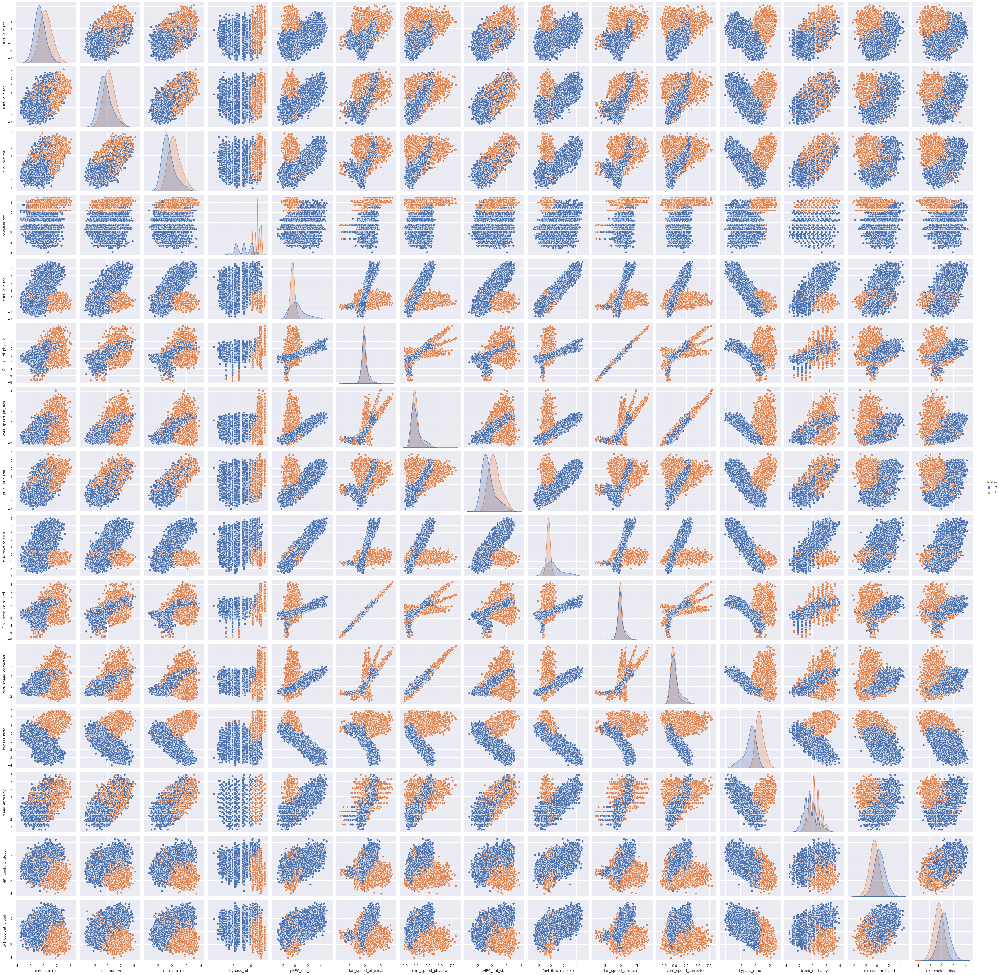

In [ ]:
x_gmm4 = X_train_regr4s.copy()
gmm4 = GaussianMixture(n_components = 2)

# Fit the GMM model for the dataset
# which expresses the dataset as a
# mixture of 4 Gaussian Distribution
gmm4.fit(x_gmm4[sensors])
x_gmm4['cluster'] = gmm4.predict(x_gmm4[sensors])


sns.pairplot(x_gmm4[sensors + ['cluster']], hue='cluster')

np.unique(gmm4.predict(x_gmm4[sensors ]), return_counts=True)
